# Evaluating different tesseract training data sets and command line options

[Tesseract command line options](http://manpages.ubuntu.com/manpages/cosmic/man1/tesseract.1.html)

In [1]:
DISPLAY_IMAGES = True

In [2]:
%pip install --upgrade pip
%pip install --user --upgrade "opencv-python"
%pip install --upgrade wget
%pip install --upgrade pytesseract

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621
DEPRECATION: Configuring installation scheme with distutils config files is deprecated a

In [3]:
import os
import wget
import cv2 
import numpy
import time
import uuid
from matplotlib import pyplot
import pytesseract
import image_utils
pyplot.rcParams['figure.dpi'] = 200
all_scores = []

In [4]:
!tesseract -v

tesseract 4.1.1
 leptonica-1.81.1
  libgif 5.2.1 : libjpeg 9d : libpng 1.6.37 : libtiff 4.3.0 : zlib 1.2.11 : libwebp 1.2.0 : libopenjp2 2.4.0
 Found AVX2
 Found AVX
 Found FMA
 Found SSE


In [5]:
def print_matrix(matrix, title):
    print(title)
    for row in matrix:
        print(row)
    print()

In [6]:
def score_matrix(answer, key):
    total_correct = 0
    for row in range(0,9):
        for column in range(0,9):
            if answer[row][column] == key[row][column]:
                total_correct += 1
    return total_correct

In [7]:
def run_test(tesseract_config, display_image=True):

    image_path = 'test-images/638720399.jpg'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[3,0,2,0,1,8,0,4,5],
              [0,0,4,0,3,6,1,0,9],
              [9,0,1,0,7,0,0,0,0],
              [0,7,6,0,2,1,0,0,0],
              [0,0,9,0,5,0,8,0,0],
              [0,0,0,7,4,0,2,1,0],
              [0,0,0,0,6,0,5,0,1],
              [2,0,3,1,8,0,4,0,0],
              [6,1,0,4,9,0,3,0,8]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/IMG_1428-low.jpg'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,0,0,0,0,0,0,0,4],
              [8,0,9,0,1,5,0,3,0],
              [0,5,6,0,2,0,0,0,9],
              [0,0,0,7,6,0,0,0,0],
              [0,0,2,0,5,0,9,0,0],
              [0,0,0,0,3,8,0,0,0],
              [7,0,0,0,8,0,6,4,0],
              [0,6,0,9,4,0,8,0,7],
              [5,0,0,0,0,0,0,0,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/IMG_1428-high.jpg'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,0,0,0,0,0,0,0,4],
              [8,0,9,0,1,5,0,3,0],
              [0,5,6,0,2,0,0,0,9],
              [0,0,0,7,6,0,0,0,0],
              [0,0,2,0,5,0,9,0,0],
              [0,0,0,0,3,8,0,0,0],
              [7,0,0,0,8,0,6,4,0],
              [0,6,0,9,4,0,8,0,7],
              [5,0,0,0,0,0,0,0,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)
        
    image_path = 'test-images/IMG_1631-low.jpg'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,0,0,0,0,0,0,0,4],
                  [8,0,9,0,1,5,0,3,0],
                  [0,5,6,0,2,0,0,0,9],
                  [0,0,0,7,6,0,0,0,0],
                  [0,0,2,0,5,0,9,0,0],
                  [0,0,0,0,3,8,0,0,0],
                  [7,0,0,0,8,0,6,4,0],
                  [0,6,0,9,4,0,8,0,7],
                  [5,0,0,0,0,0,0,0,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/IMG_1631-high.jpg'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,0,0,0,0,0,0,0,4],
                  [8,0,9,0,1,5,0,3,0],
                  [0,5,6,0,2,0,0,0,9],
                  [0,0,0,7,6,0,0,0,0],
                  [0,0,2,0,5,0,9,0,0],
                  [0,0,0,0,3,8,0,0,0],
                  [7,0,0,0,8,0,6,4,0],
                  [0,6,0,9,4,0,8,0,7],
                  [5,0,0,0,0,0,0,0,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/Sudoku_20200509.png'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,4,0,0,9,0,0,0,2],
                  [2,0,0,0,0,3,0,0,7],
                  [8,6,0,0,0,7,0,9,0],
                  [0,0,0,0,6,5,0,2,0],
                  [5,0,0,0,0,0,0,0,9],
                  [0,9,0,7,3,0,0,0,0],
                  [0,8,0,1,0,0,0,4,3],
                  [1,0,0,4,0,0,0,0,6],
                  [4,0,0,0,2,0,0,5,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/sudoku2.png'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,0,0,8,5,0,0,0,7],
                  [3,8,2,0,0,0,0,0,0],
                  [9,0,7,0,3,0,1,8,4],
                  [0,2,8,0,0,6,0,3,0],
                  [4,0,9,0,0,0,8,0,1],
                  [0,3,0,9,0,0,4,7,0],
                  [7,1,3,0,6,0,2,0,8],
                  [0,0,0,0,0,0,5,1,6],
                  [2,0,0,0,9,8,0,0,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/sudokupuzzler.26.jpg'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image, tesseract_config)

    answer_key = [[0,0,0,5,0,1,0,0,0],
                  [0,9,1,0,0,8,0,5,0],
                  [0,0,8,0,9,0,1,4,0],
                  [1,0,0,0,5,0,0,2,9],
                  [0,0,5,2,4,9,7,0,0],
                  [2,7,0,0,8,0,0,0,4],
                  [0,5,4,0,3,0,6,0,0],
                  [0,6,0,7,0,0,9,3,0],
                  [0,0,0,9,0,5,0,0,0]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/Sudoku Error.png'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image)

    answer_key = [[8,0,6,0,1,0,0,0,0],
                  [0,0,3,0,6,4,0,9,0],
                  [9,0,0,0,0,0,8,1,6],
                  [0,8,0,3,9,6,0,0,0],
                  [7,0,2,0,4,0,3,0,9],
                  [0,0,0,5,7,2,0,8,0],
                  [5,2,1,0,0,0,0,0,4],
                  [0,3,0,7,5,0,2,0,0],
                  [0,0,0,0,2,0,1,0,5]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

    image_path = 'test-images/Sudoku Error2.png'
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    input_matrix, image_with_ocr, image_with_lines, coordinates = image_utils.extract_matrix_from_image(image)

    answer_key = [[8,0,6,0,1,0,0,0,0],
                  [0,0,3,0,6,4,0,9,0],
                  [9,0,0,0,0,0,8,1,6],
                  [0,8,0,3,9,6,0,0,0],
                  [7,0,2,0,4,0,3,0,9],
                  [0,0,0,5,7,2,0,8,0],
                  [5,2,1,0,0,0,0,0,4],
                  [0,3,0,7,5,0,2,0,0],
                  [0,0,0,0,2,0,1,0,5]]

    score = score_matrix(input_matrix, answer_key)
    print('Image: %s \t\tScore: %s' % (image_path, score))
    all_scores.append((tesseract_config, image_path, score))
    if display_image:
        image_utils.show_image(image_with_ocr, image_path)

# Default data

Start Time: 1660184292.95
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

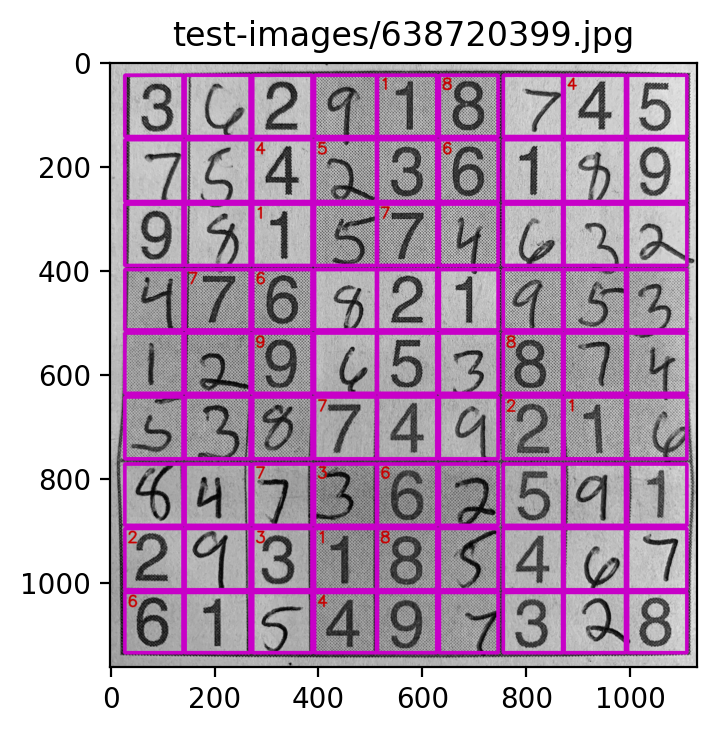

Start Time: 1660184299.39
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

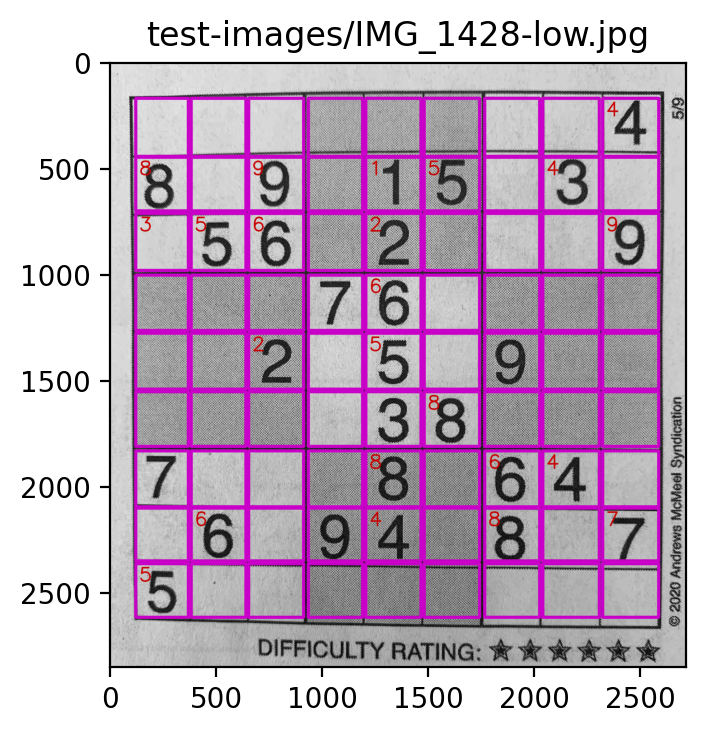

Start Time: 1660184307.02
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

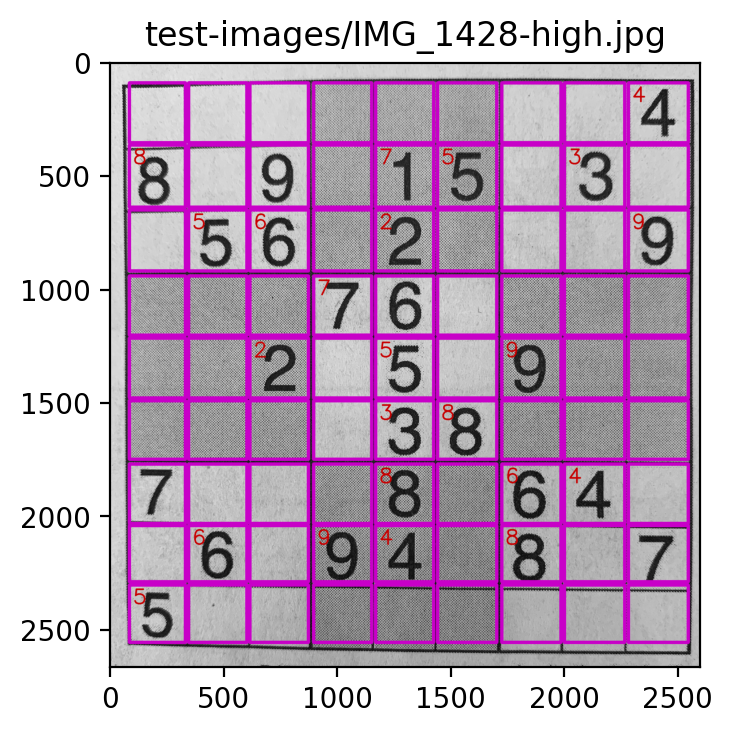

Start Time: 1660184314.27
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

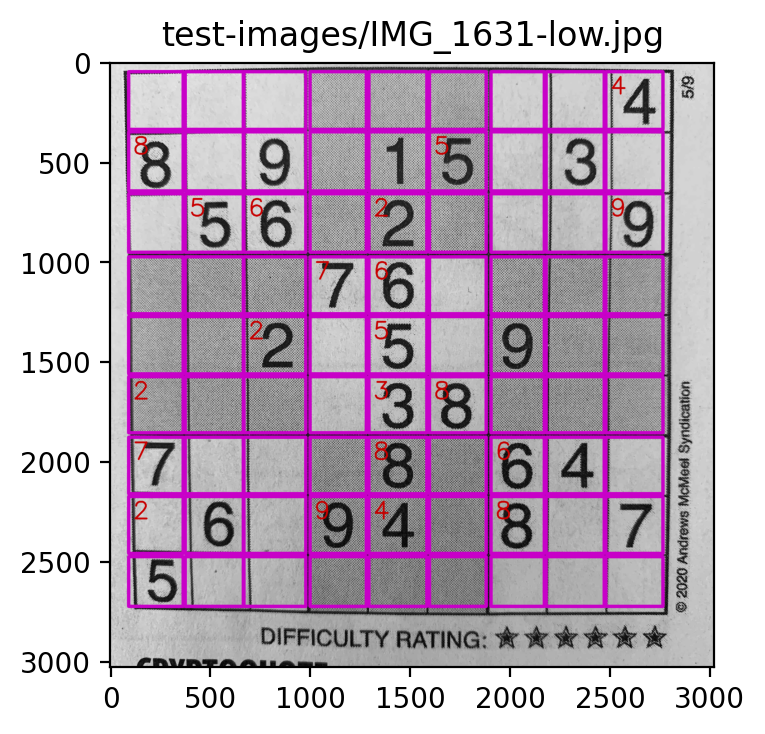

Start Time: 1660184323.66
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

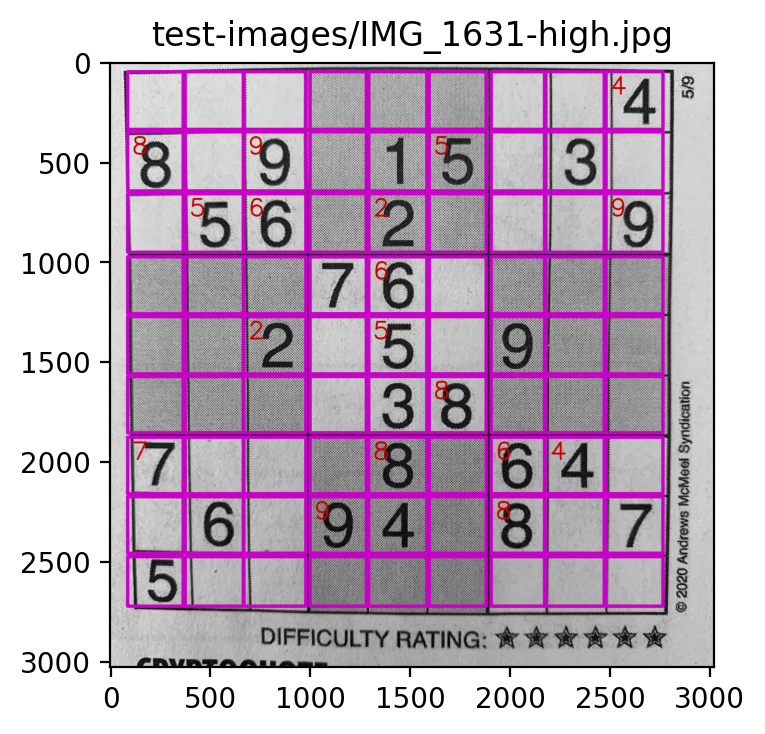

Start Time: 1660184333.79
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

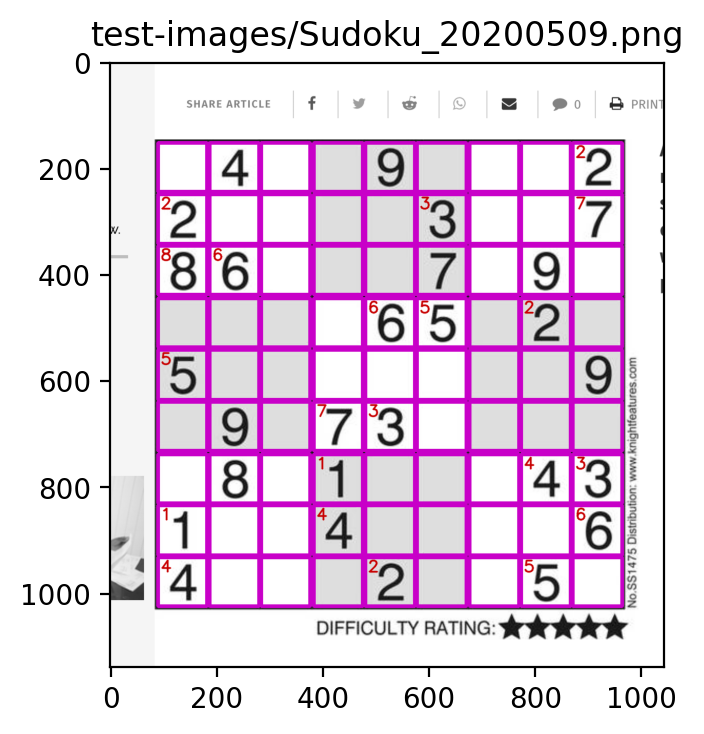

Start Time: 1660184338.84
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

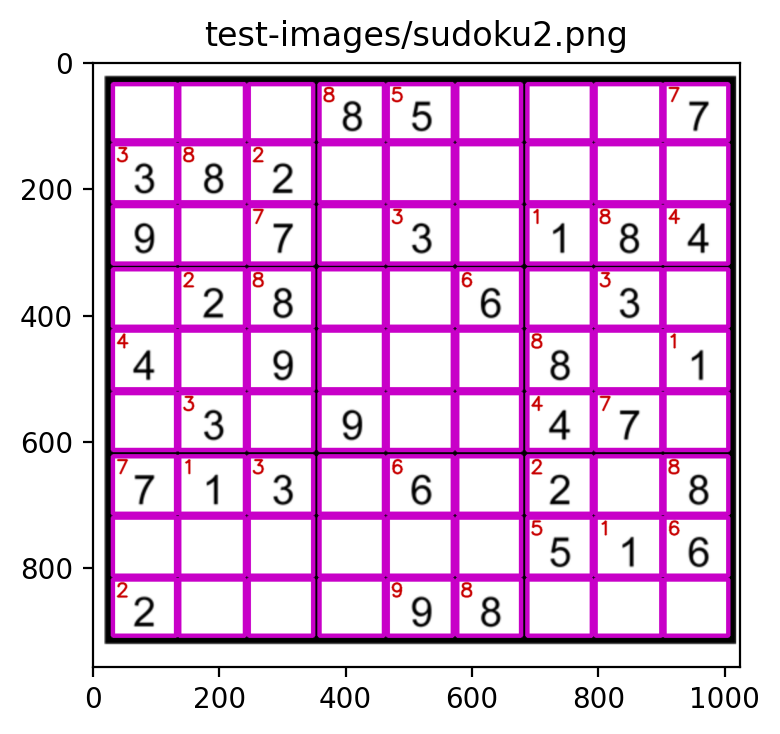

Start Time: 1660184345.15
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

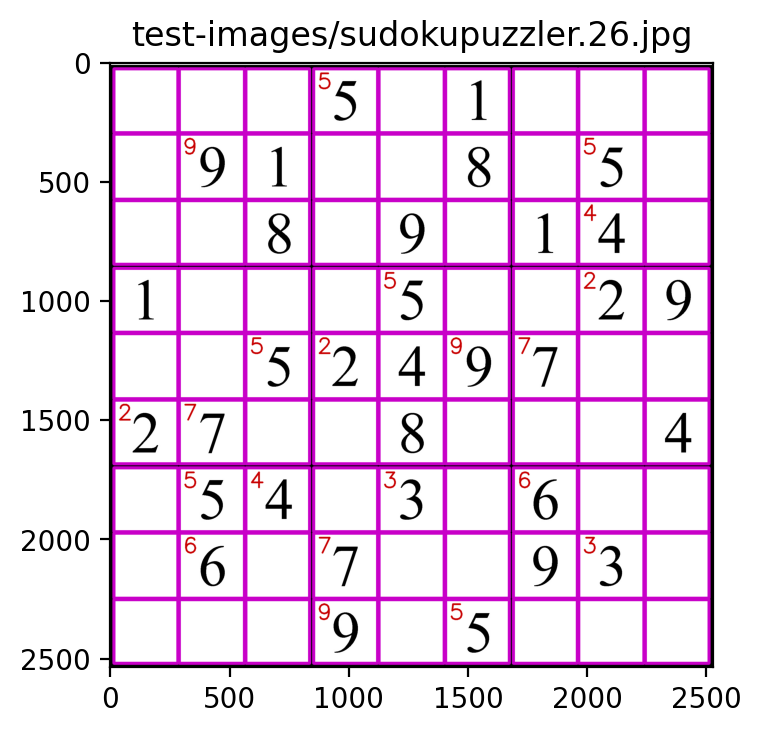

Start Time: 1660184351.99
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

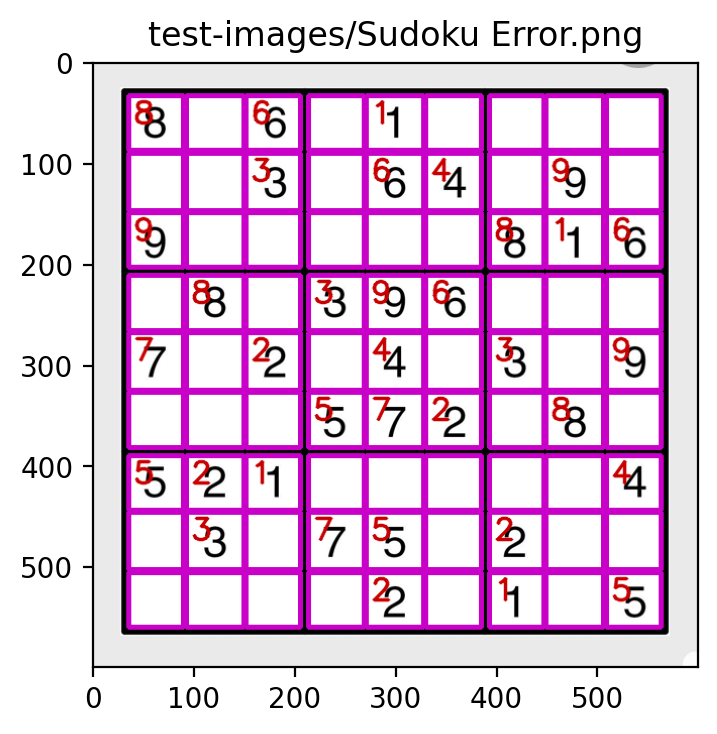

Start Time: 1660184361.08
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

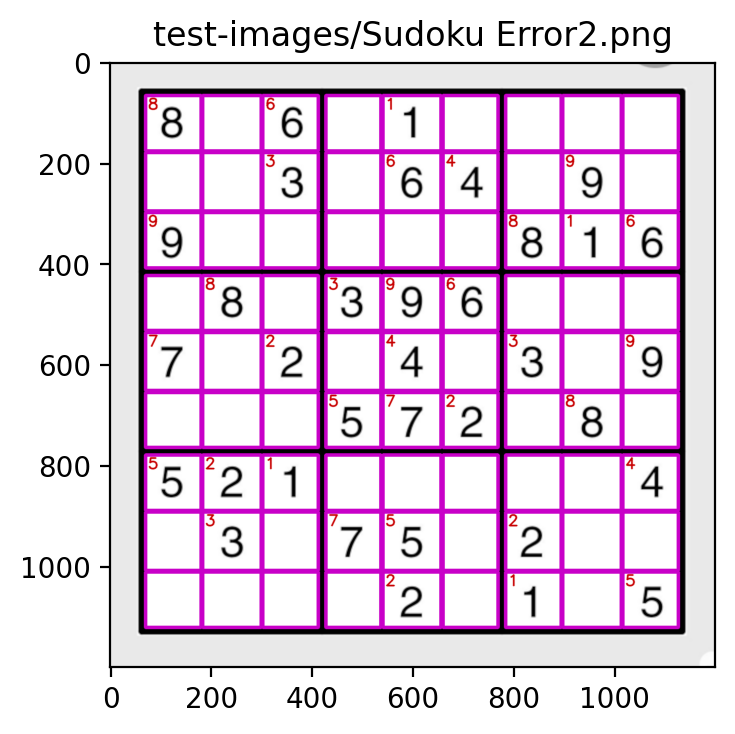

In [8]:
run_test('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', display_image=DISPLAY_IMAGES)
# With oem values of 0,2, this fails with the following error:
# Error: Tesseract (legacy) engine requested, but components are not present in /usr/local/share/tessdata/eng.traineddata!! 

Start Time: 1660184370.44
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

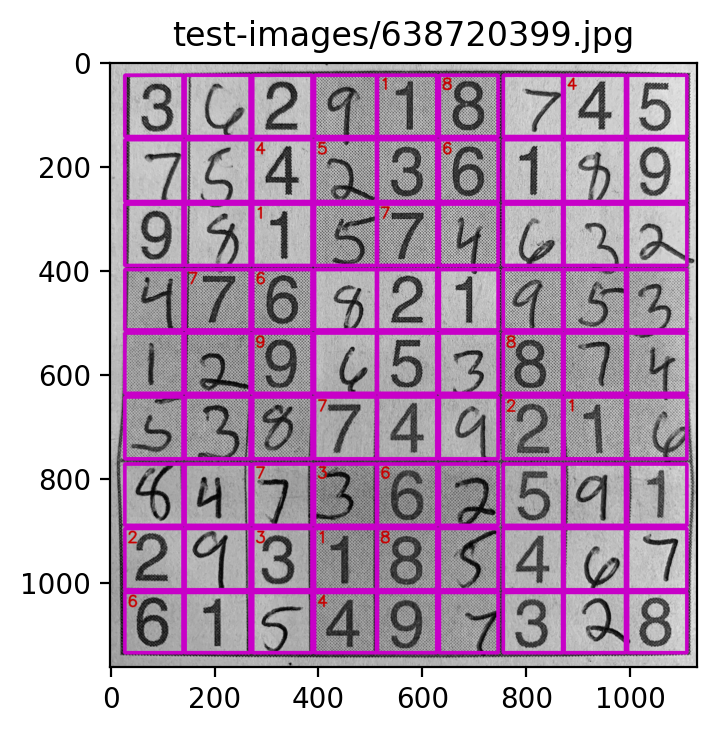

Start Time: 1660184377.04
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

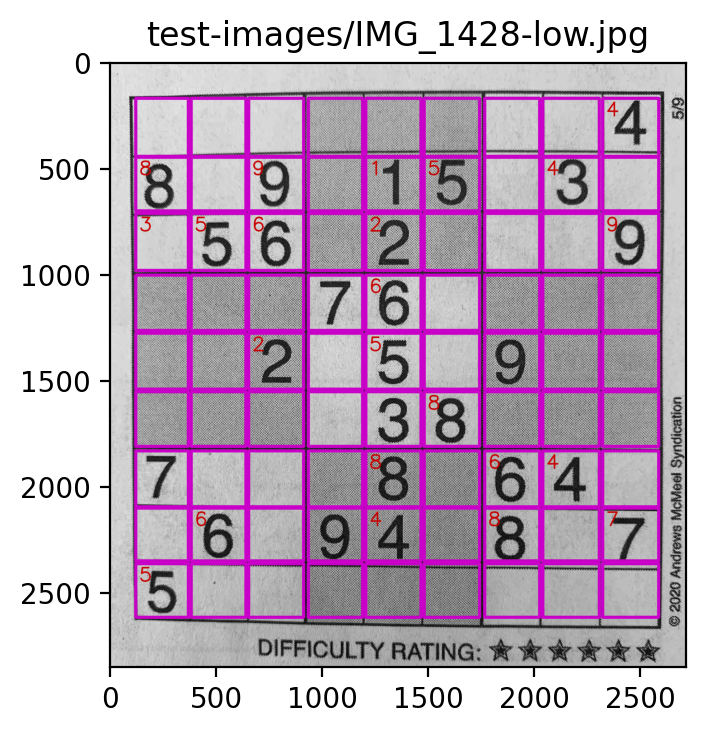

Start Time: 1660184384.76
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

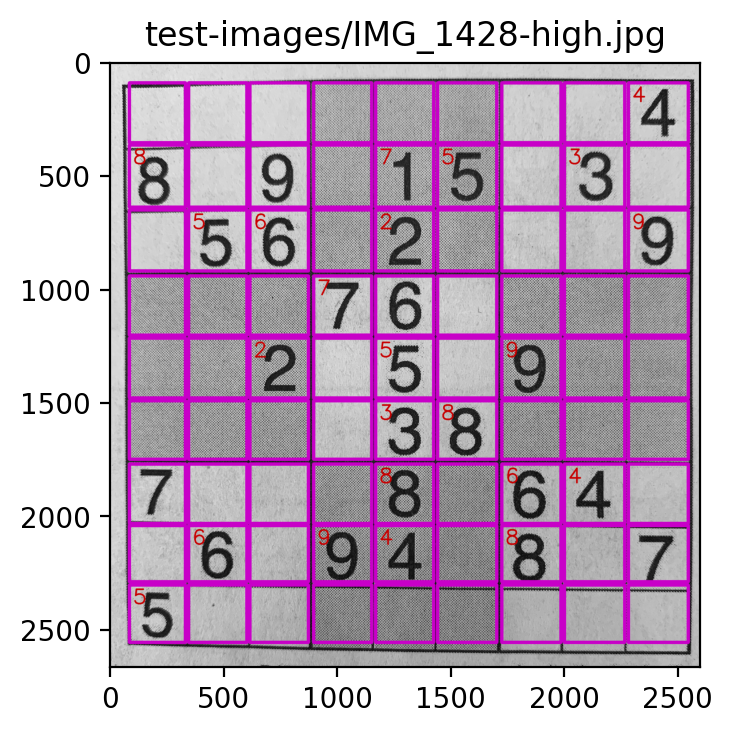

Start Time: 1660184392.17
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

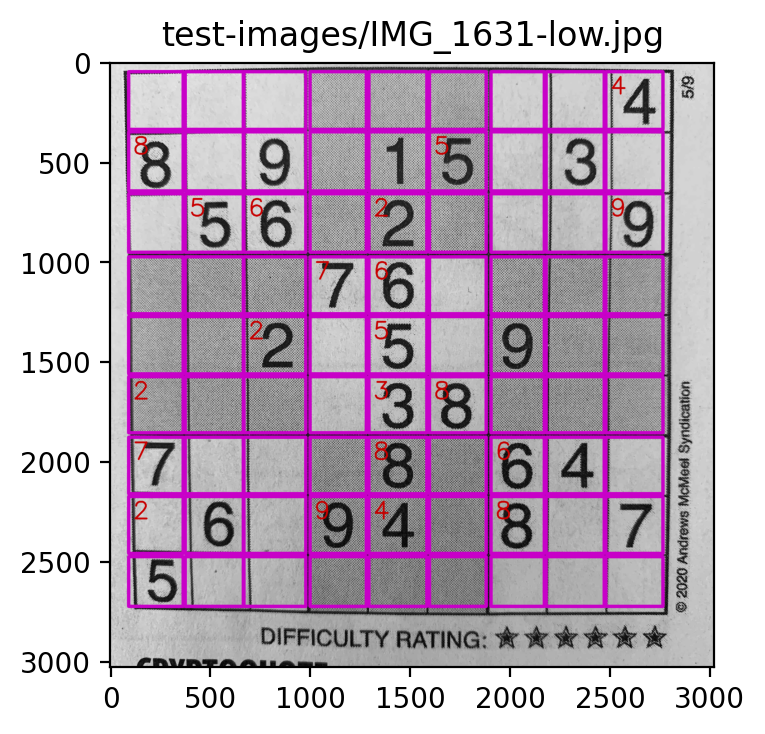

Start Time: 1660184401.71
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

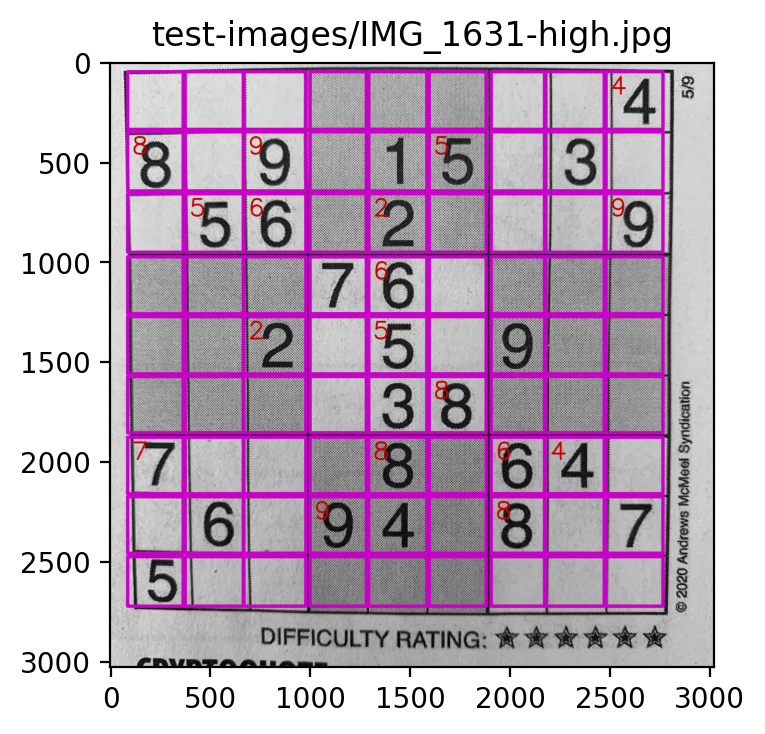

Start Time: 1660184411.92
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

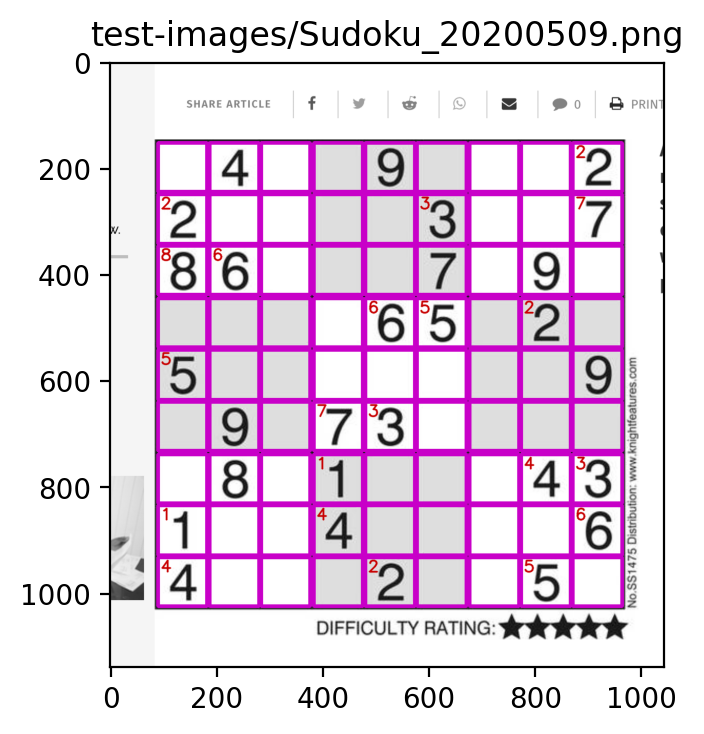

Start Time: 1660184416.98
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

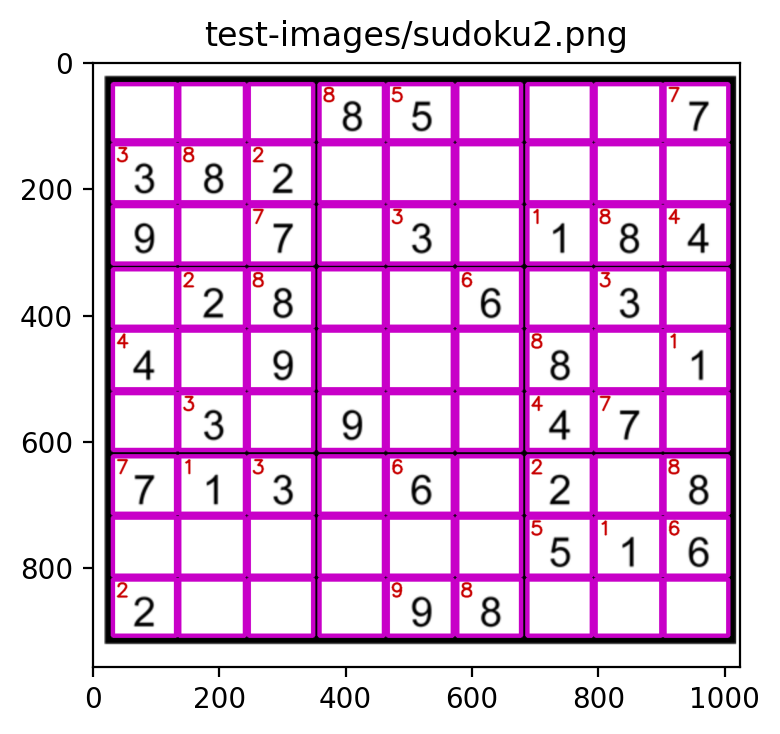

Start Time: 1660184423.44
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

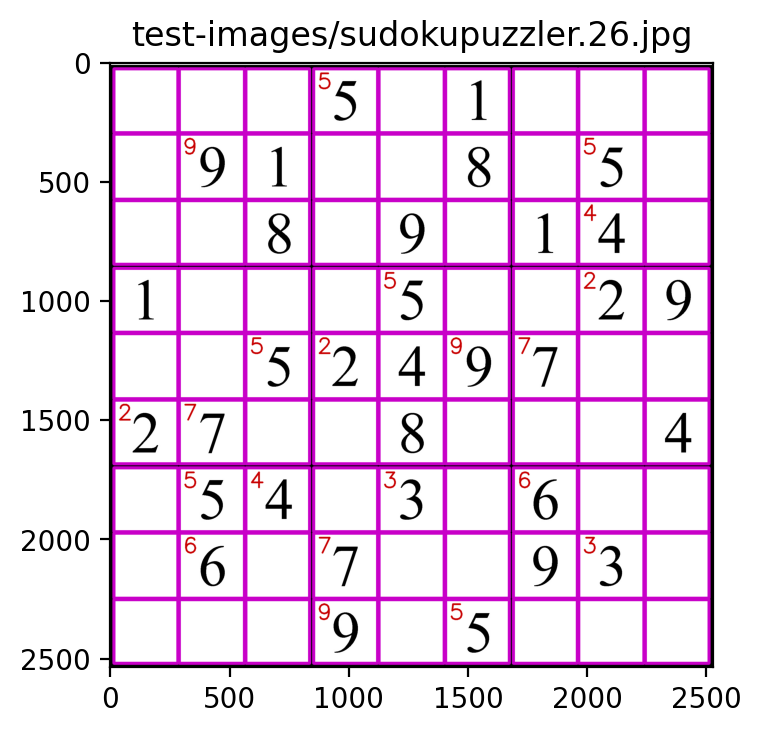

Start Time: 1660184430.34
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

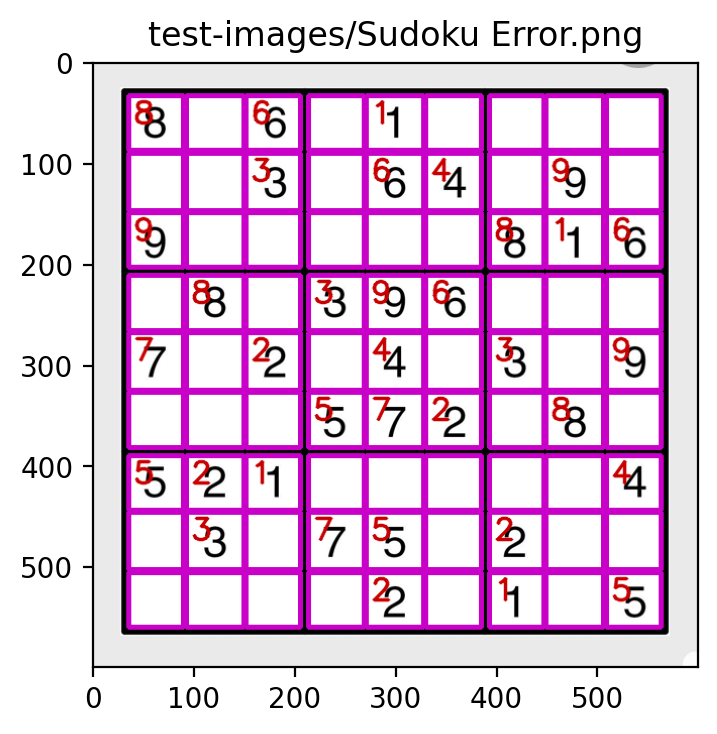

Start Time: 1660184439.31
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

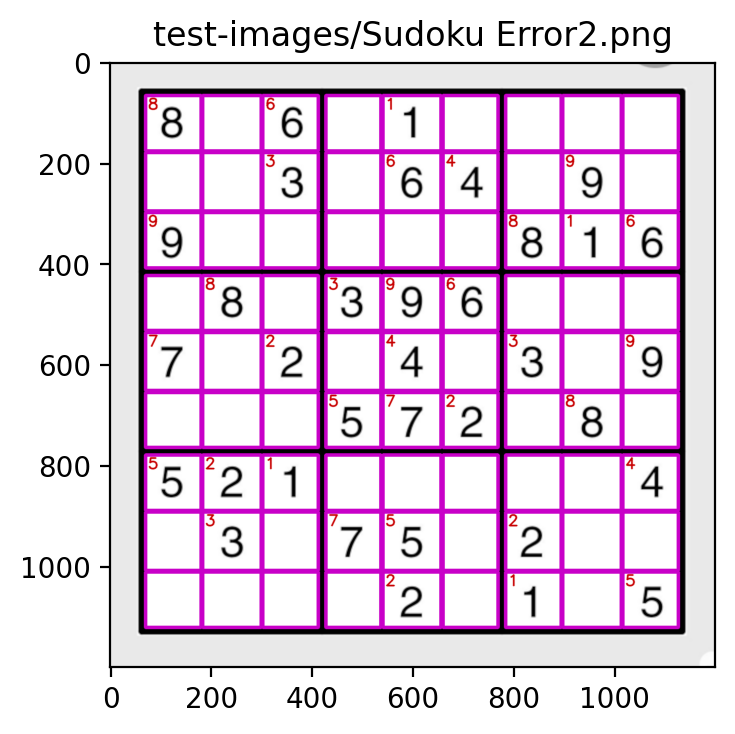

In [9]:
run_test('--psm 10 --oem 3 -l eng -c tessedit_char_whitelist=123456789', display_image=DISPLAY_IMAGES)

Start Time: 1660184448.62
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

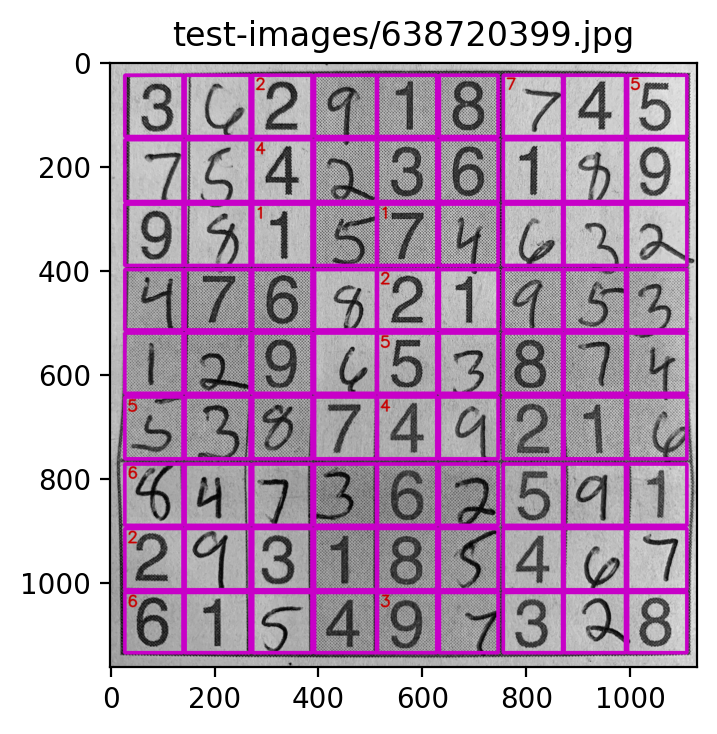

Start Time: 1660184464.25
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

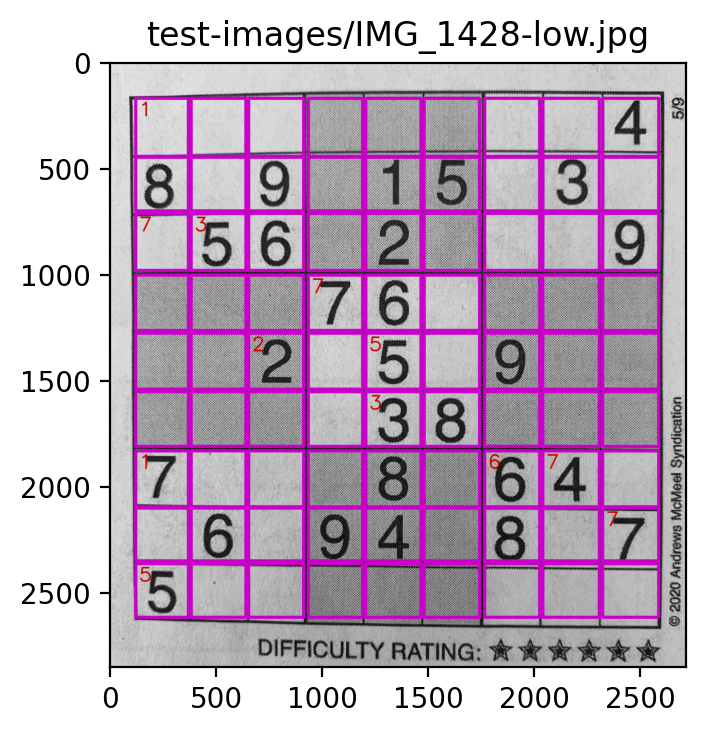

Start Time: 1660184475.49
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

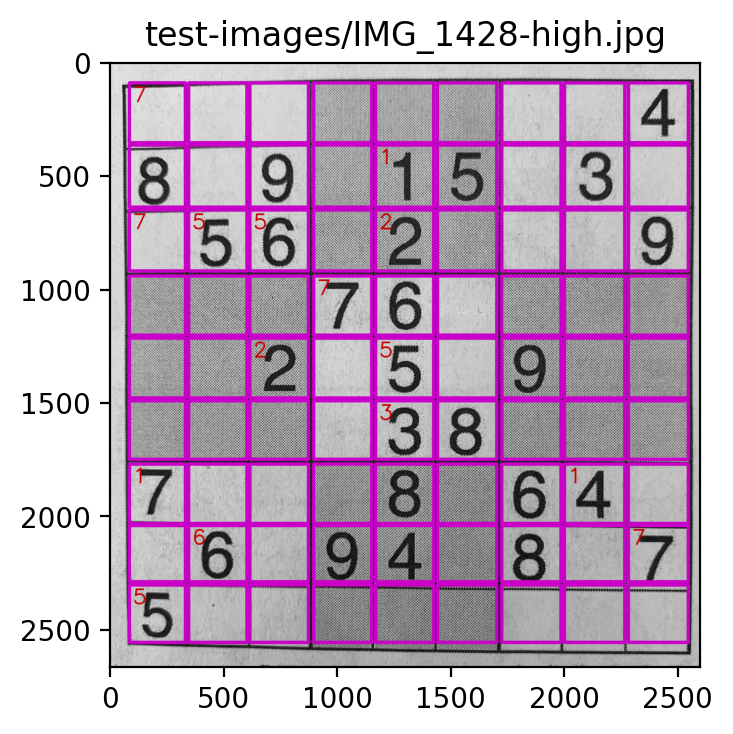

Start Time: 1660184485.41
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

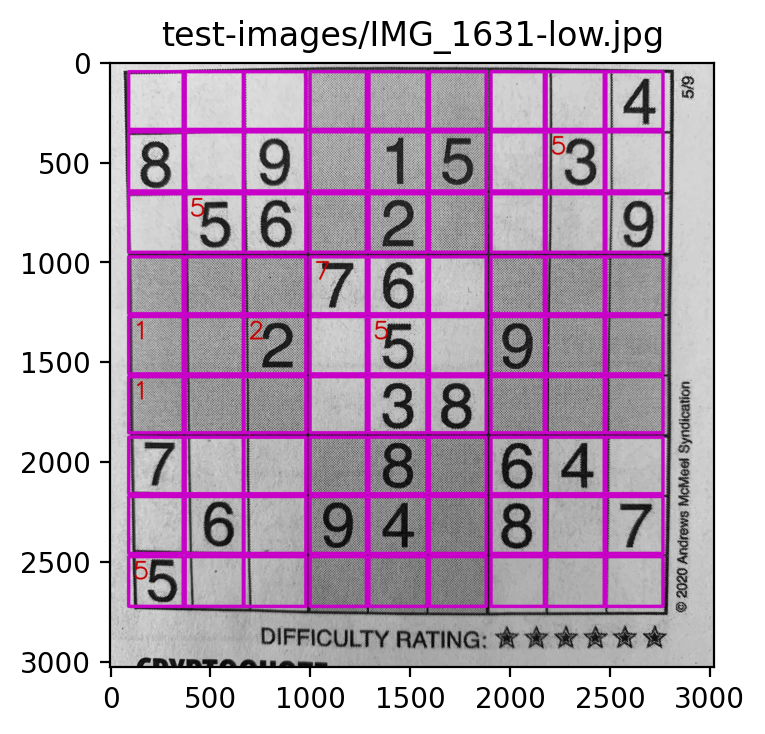

Start Time: 1660184501.39
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

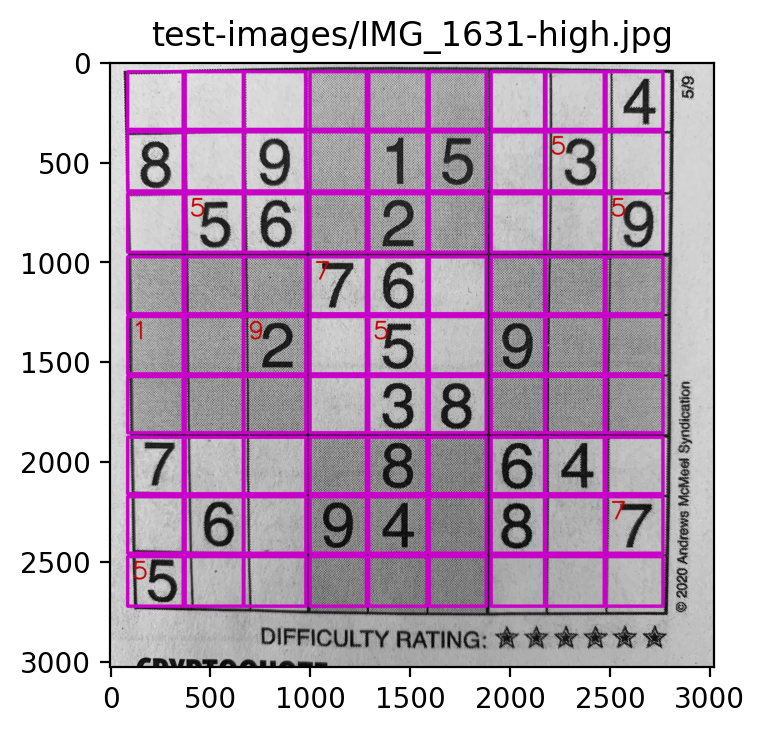

Start Time: 1660184517.03
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

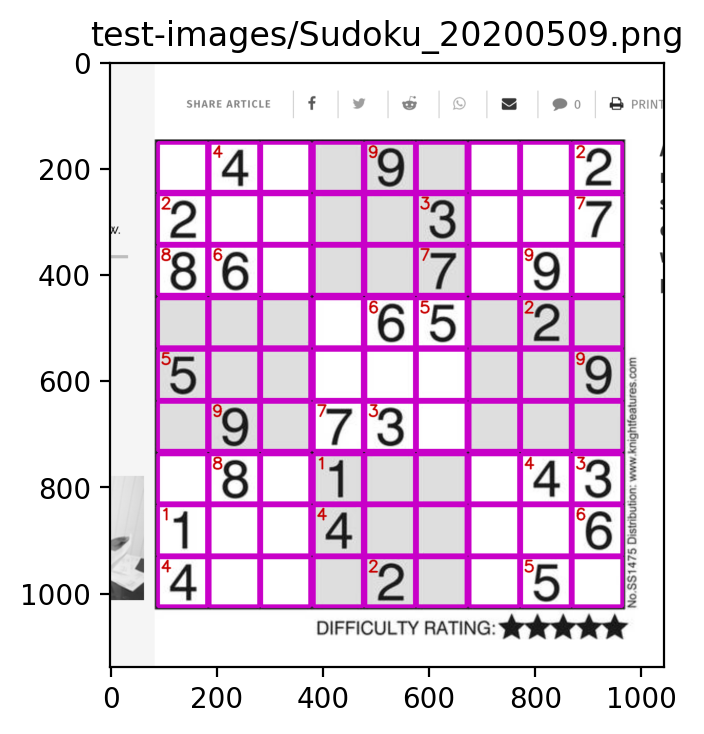

Start Time: 1660184524.57
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

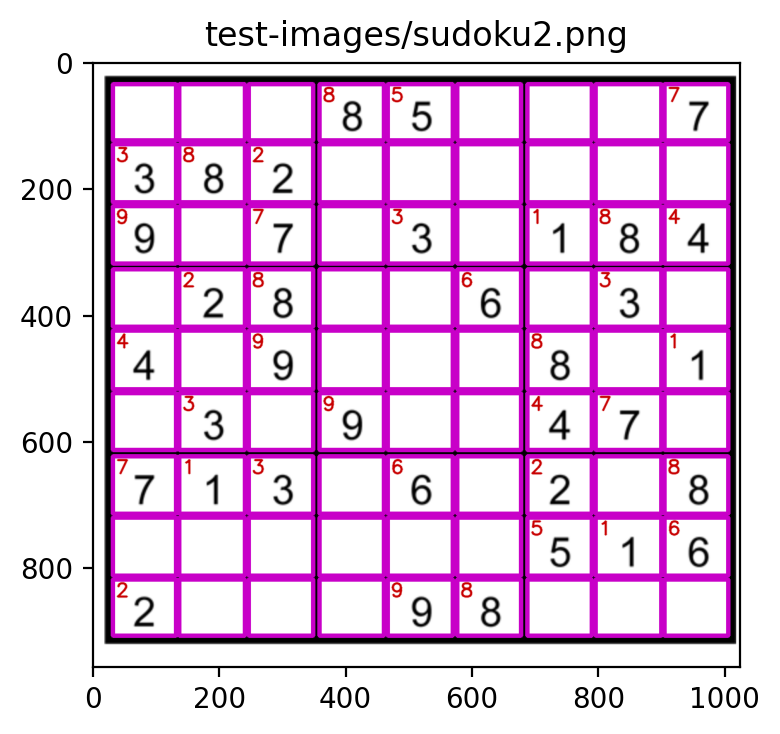

Start Time: 1660184534.13
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

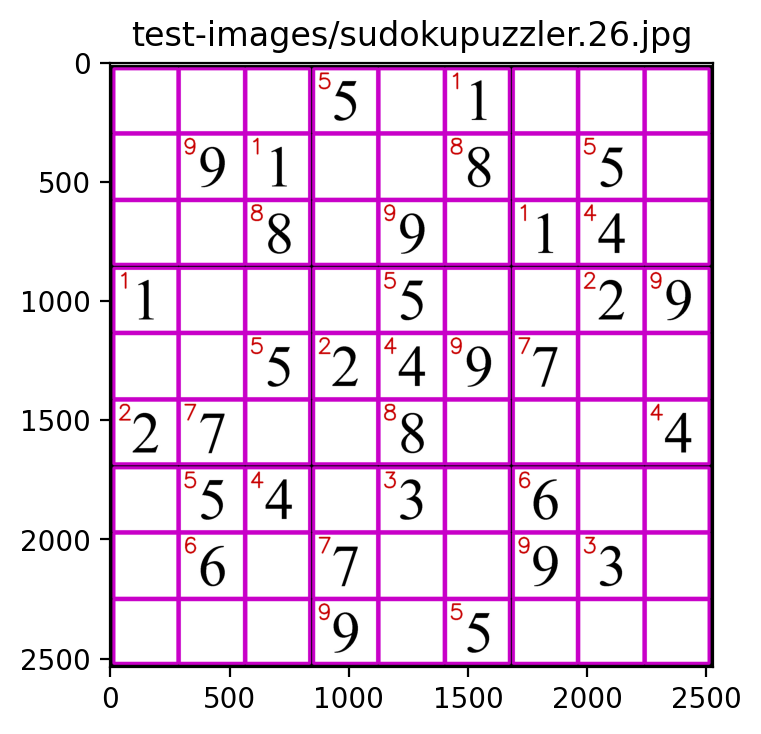

Start Time: 1660184543.86
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

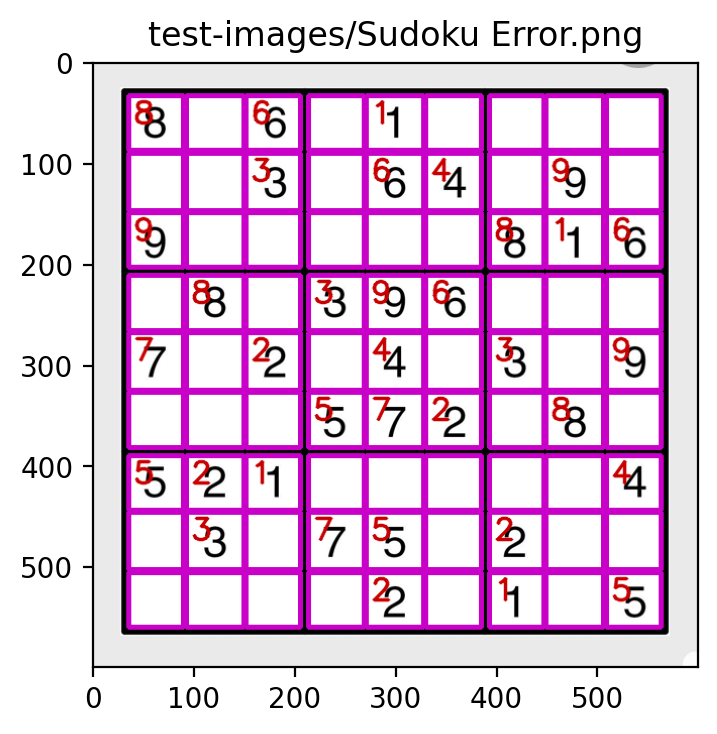

Start Time: 1660184552.99
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

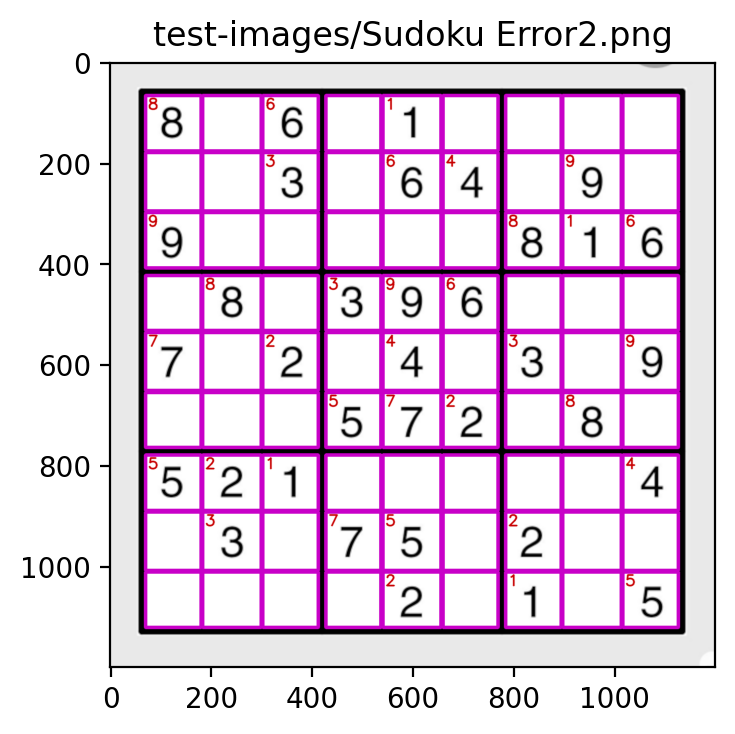

In [10]:
run_test('--psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016', display_image=DISPLAY_IMAGES)

Start Time: 1660184562.53
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

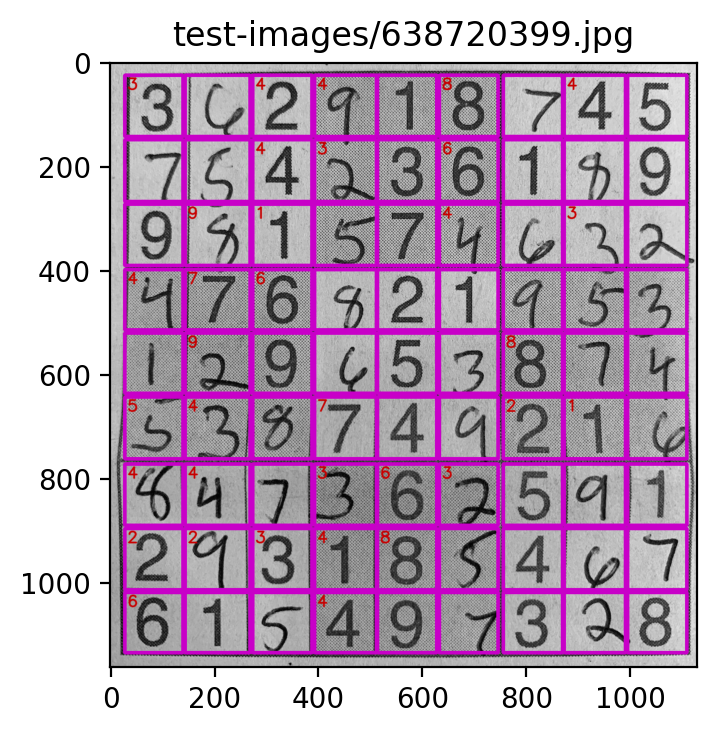

Start Time: 1660184571.96
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

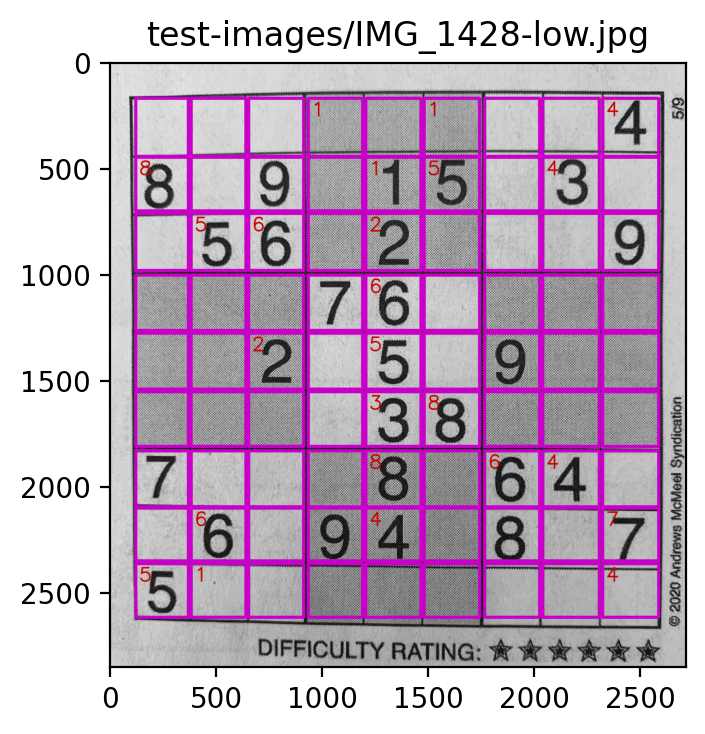

Start Time: 1660184584.47
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

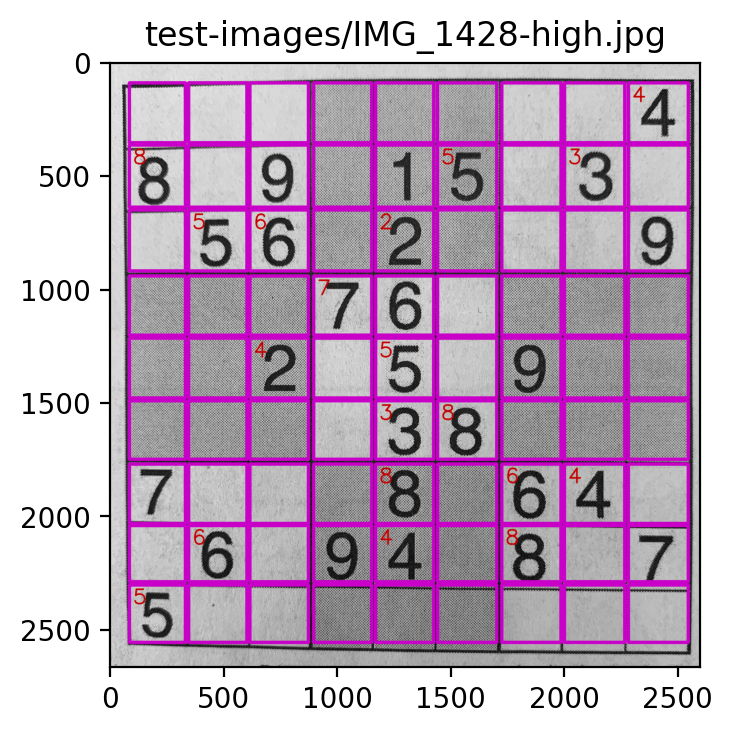

Start Time: 1660184594.65
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

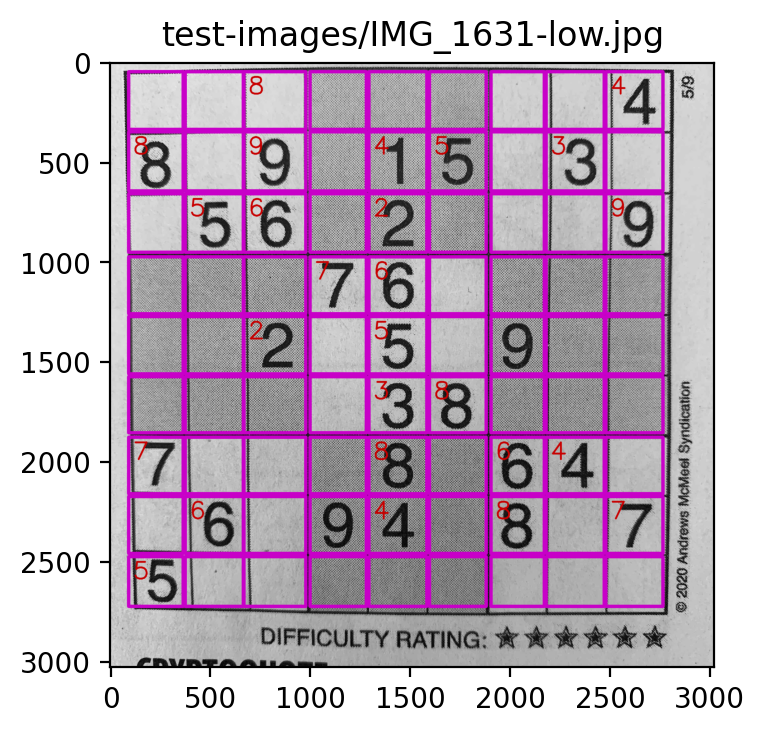

Start Time: 1660184605.05
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

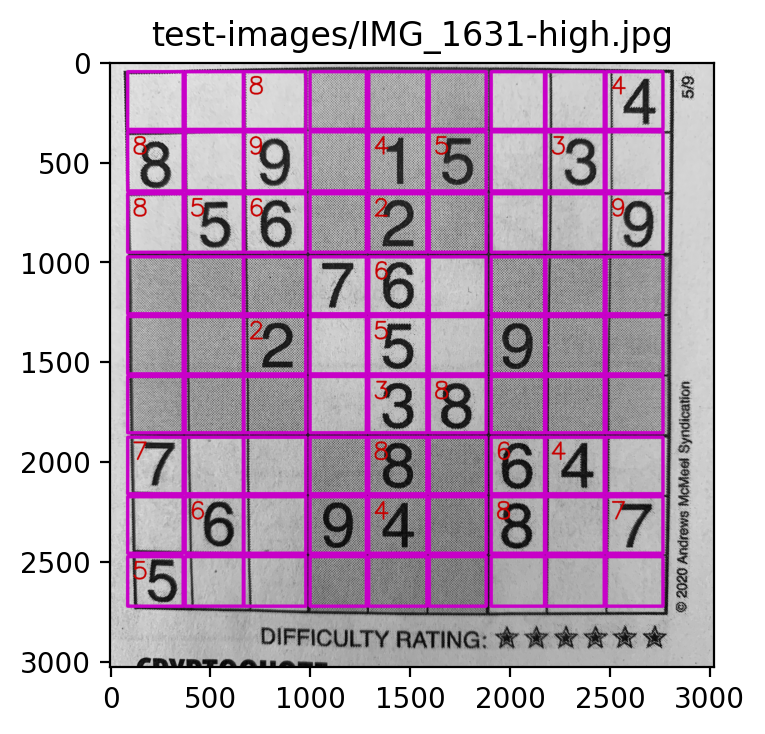

Start Time: 1660184615.89
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

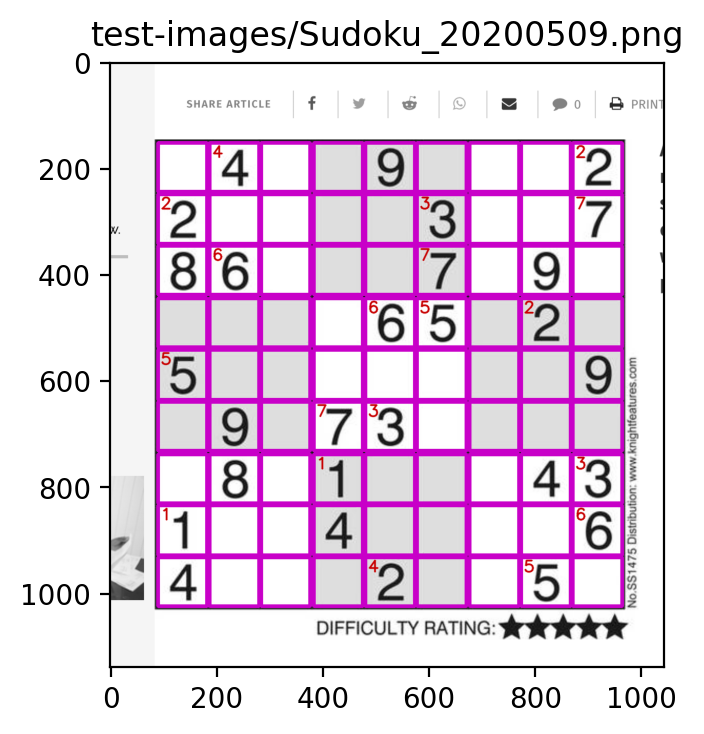

Start Time: 1660184623.62
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

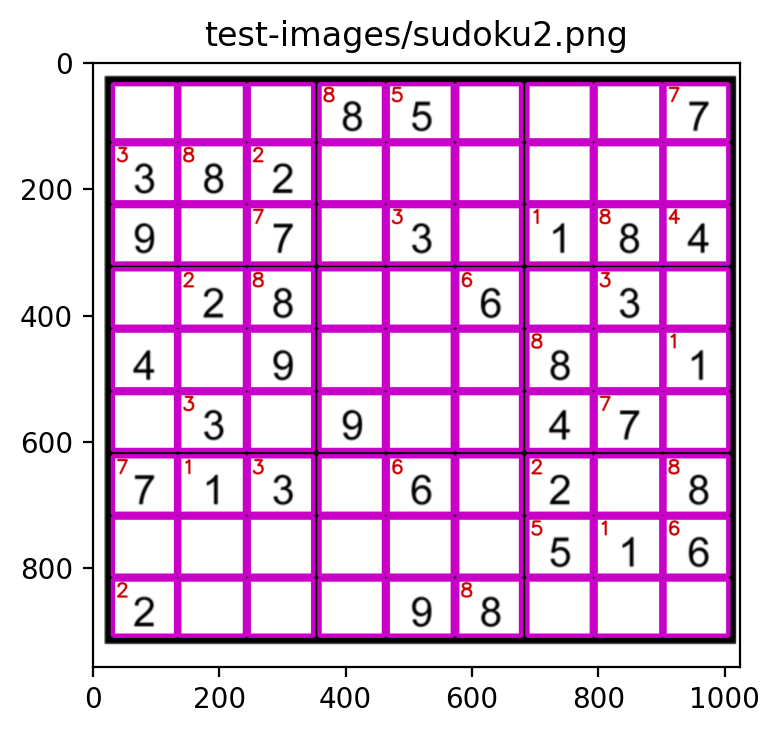

Start Time: 1660184633.33
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

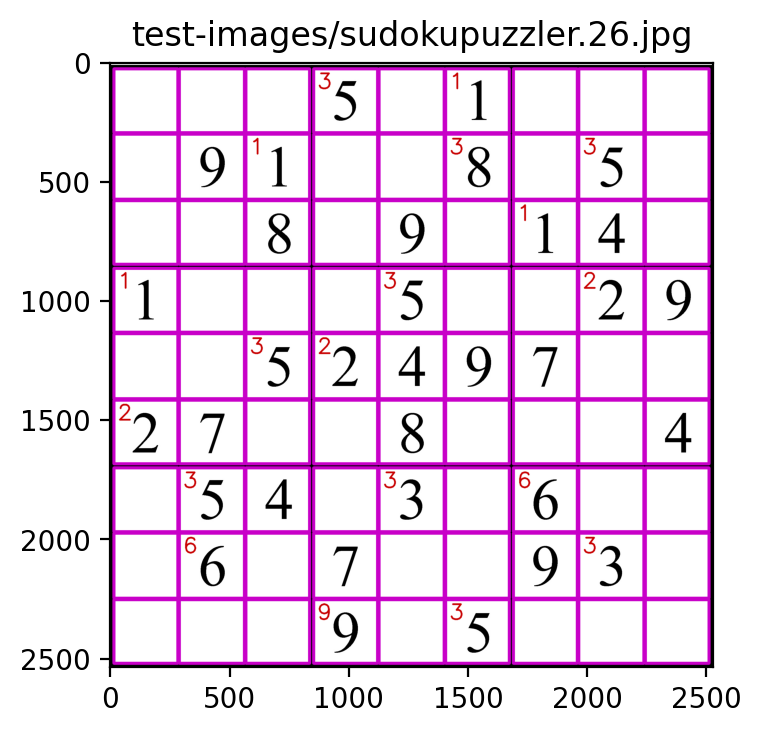

Start Time: 1660184643.42
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

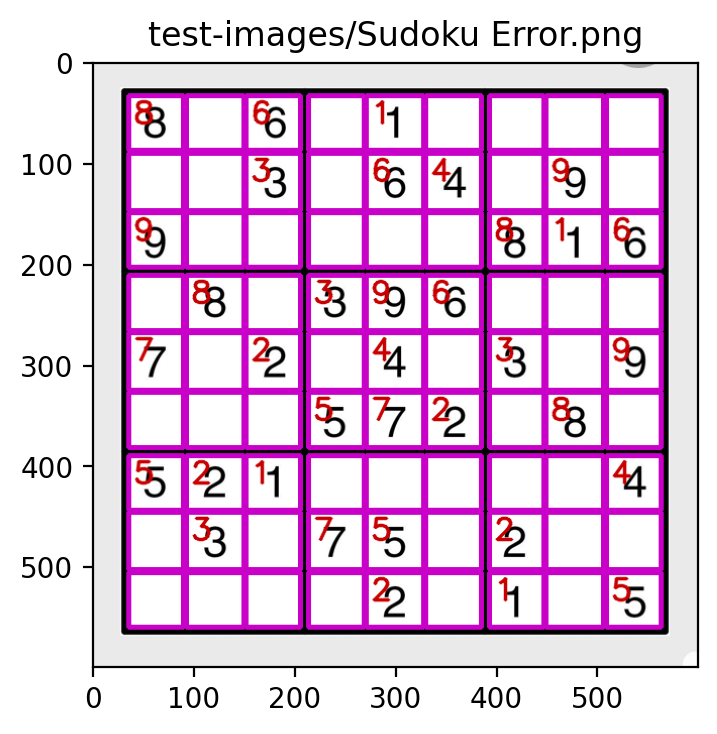

Start Time: 1660184653.43
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

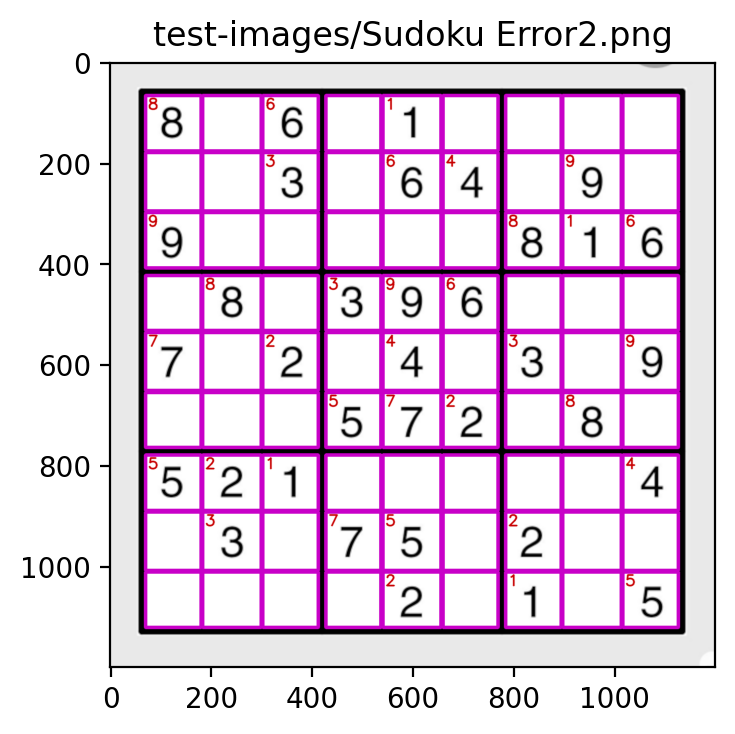

In [11]:
run_test('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016', display_image=DISPLAY_IMAGES)

Start Time: 1660184662.41
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

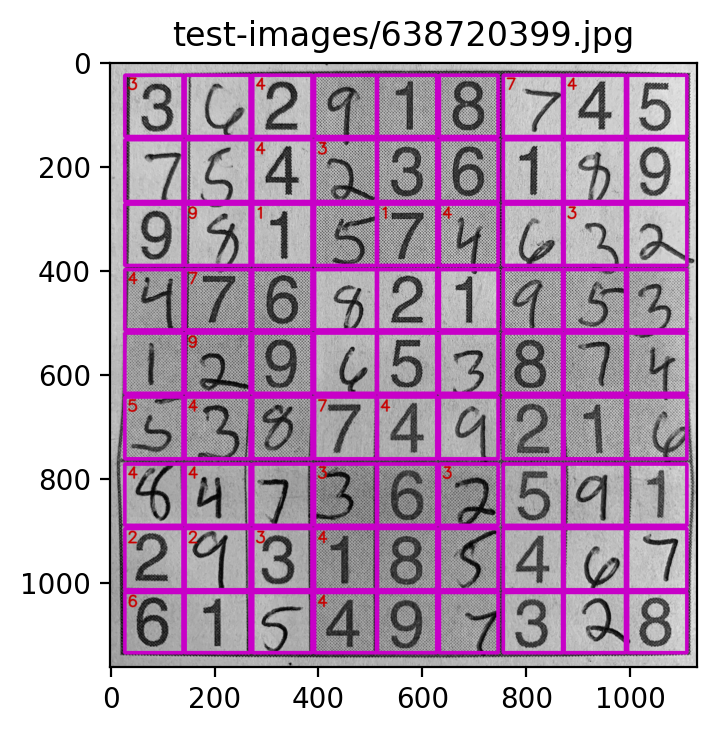

Start Time: 1660184672.64
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

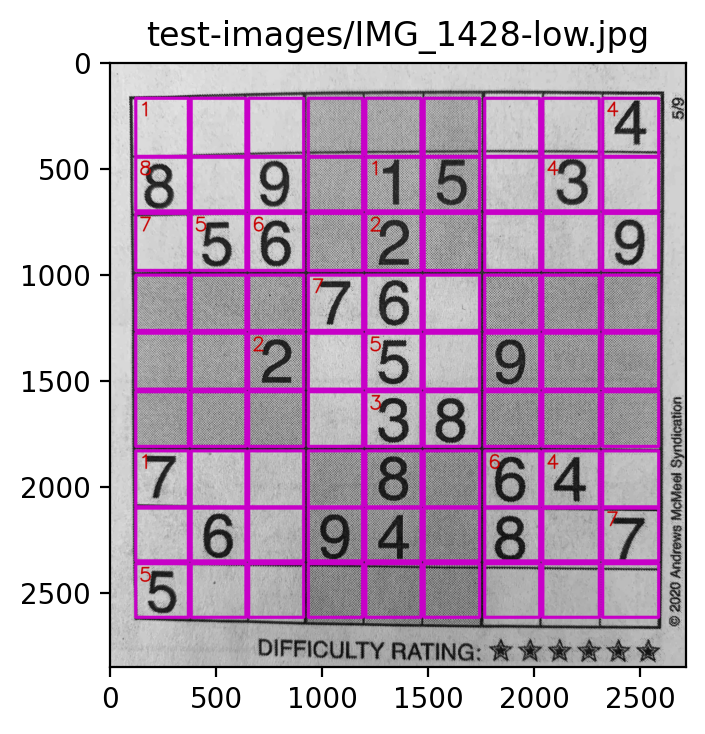

Start Time: 1660184683.31
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

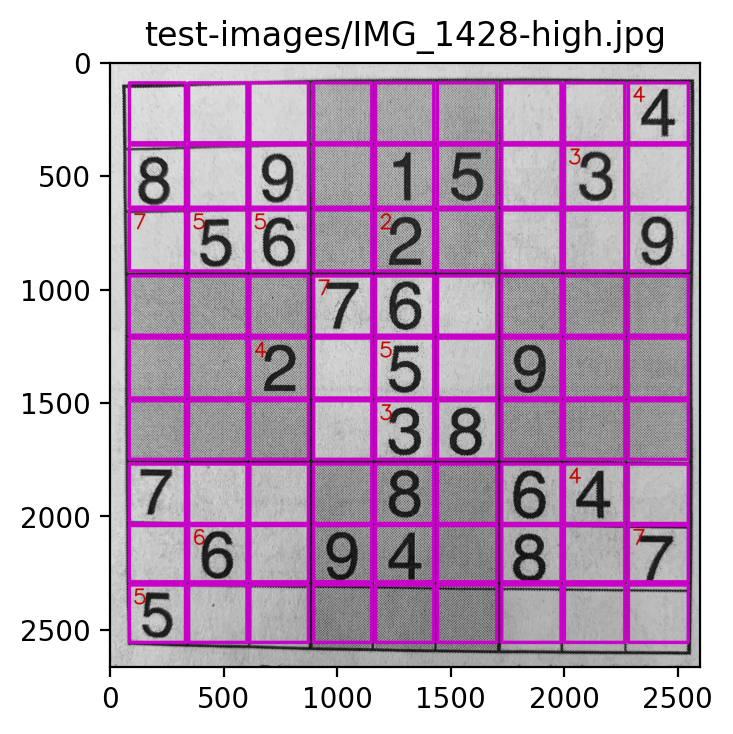

Start Time: 1660184696.52
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

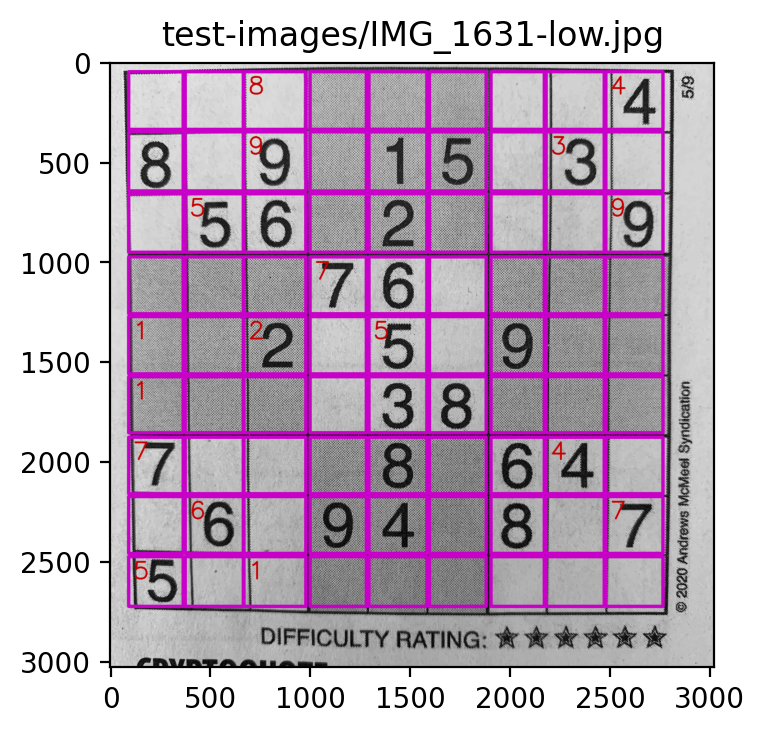

Start Time: 1660184714.61
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

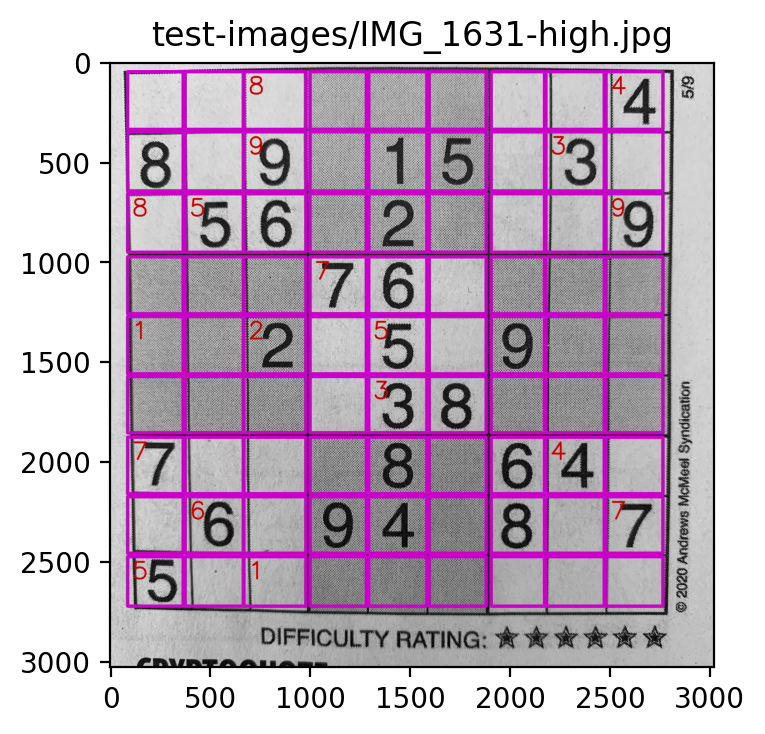

Start Time: 1660184729.55
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

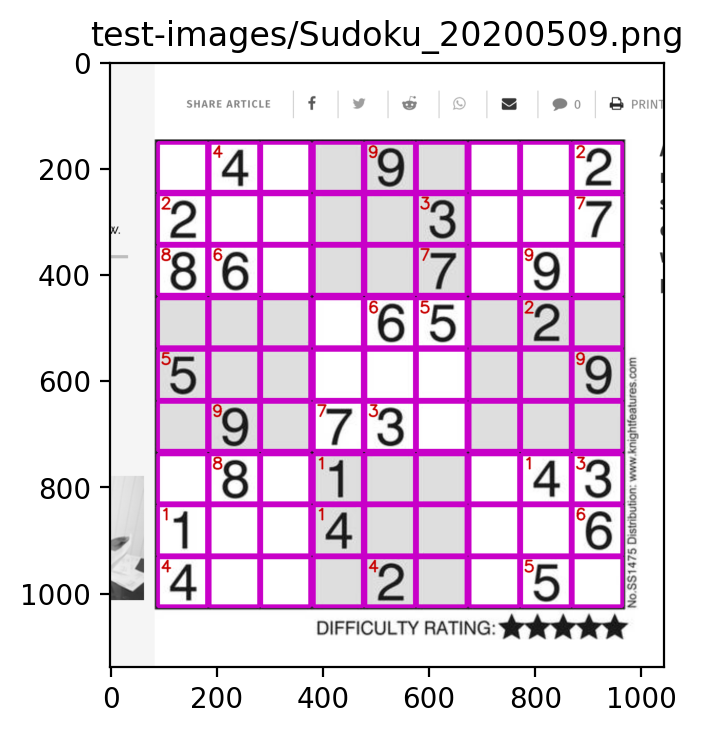

Start Time: 1660184738.67
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

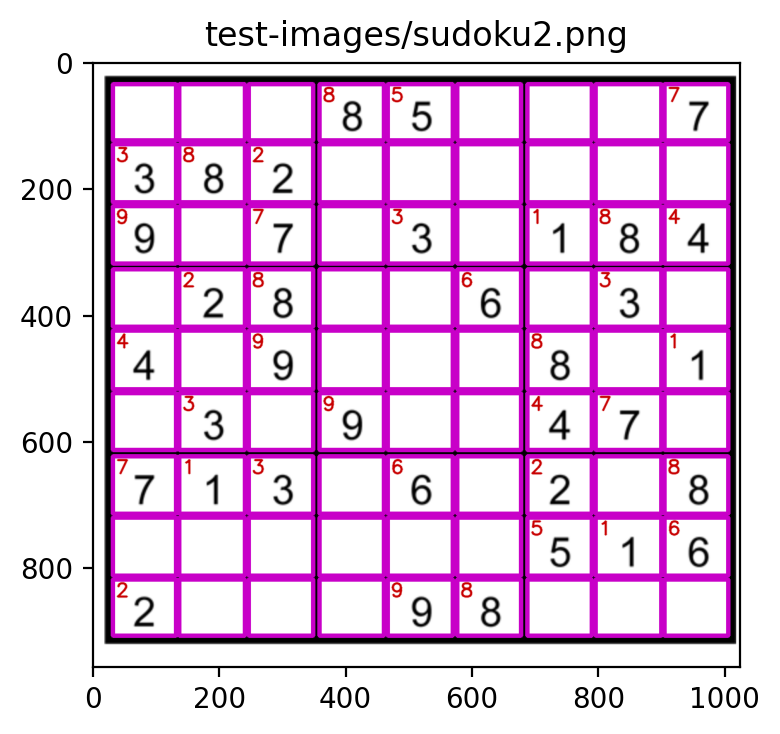

Start Time: 1660184750.24
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

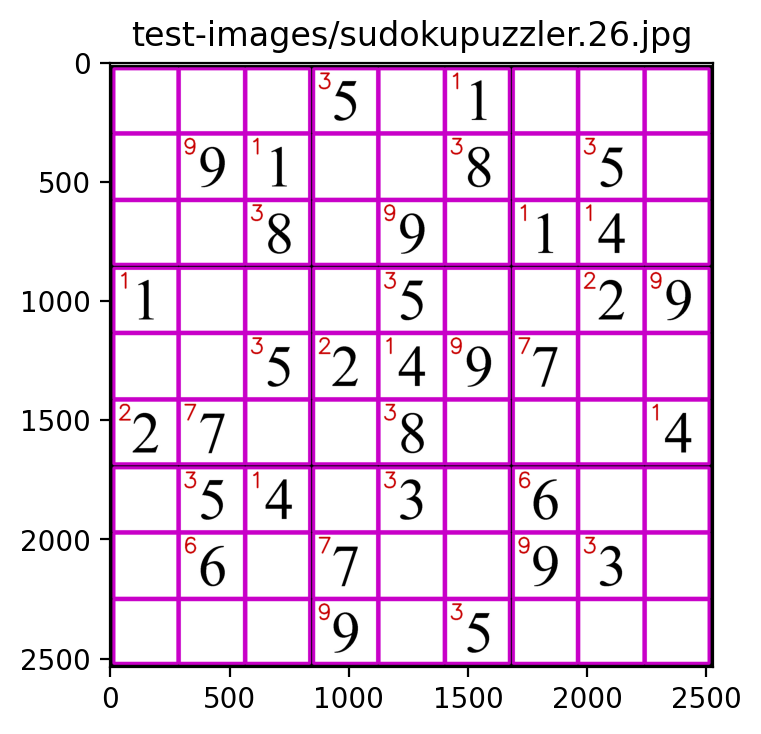

Start Time: 1660184762.09
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

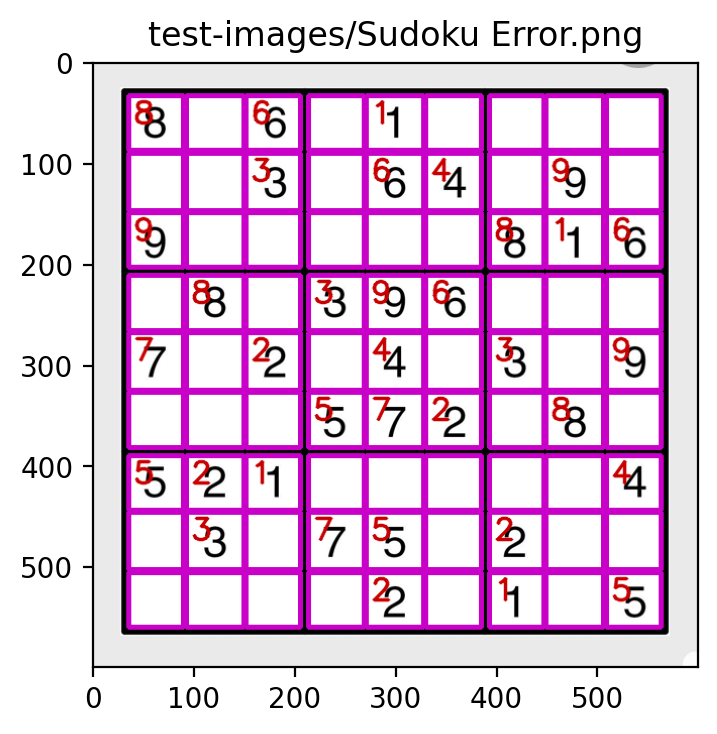

Start Time: 1660184772.81
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

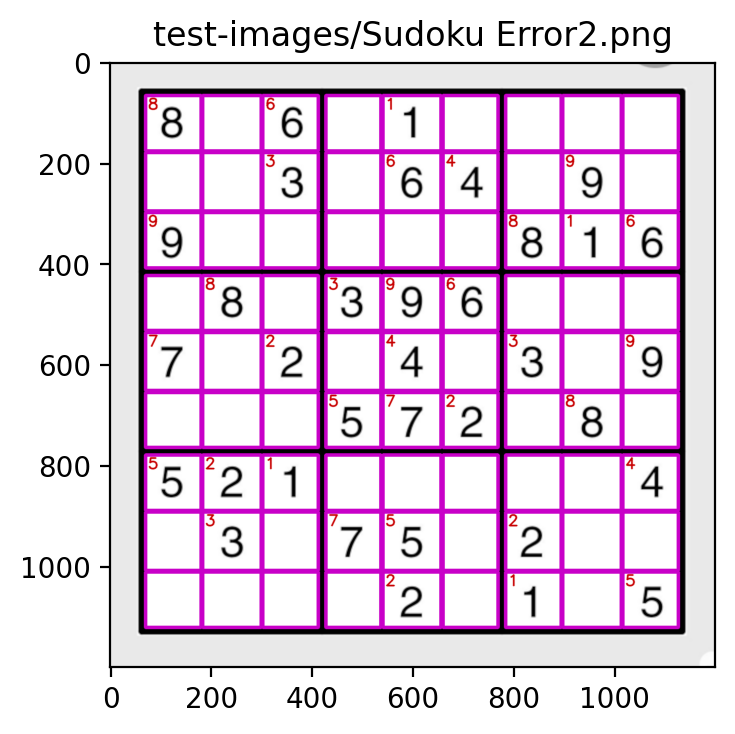

In [12]:
run_test('--psm 10 --oem 2 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016', display_image=DISPLAY_IMAGES)

Start Time: 1660184783.30
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

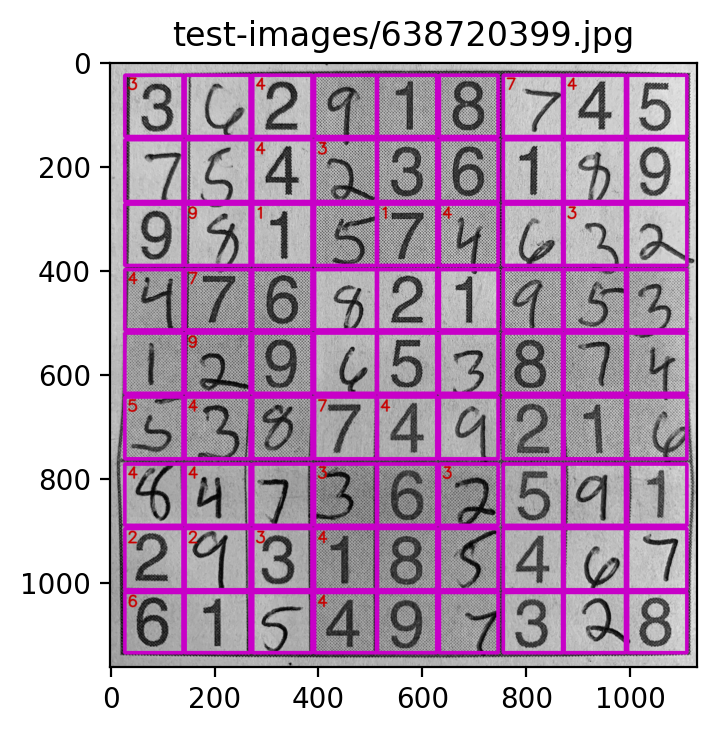

Start Time: 1660184794.35
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

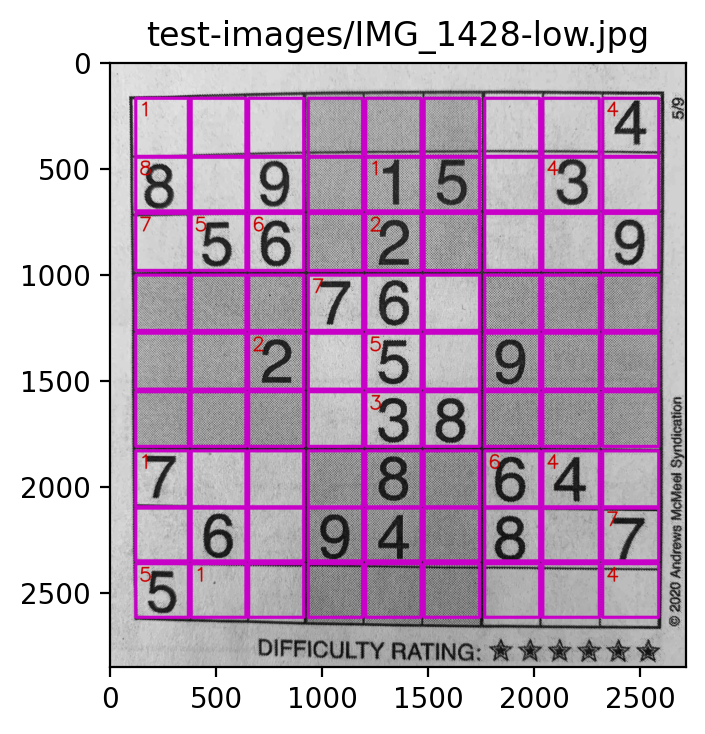

Start Time: 1660184809.63
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

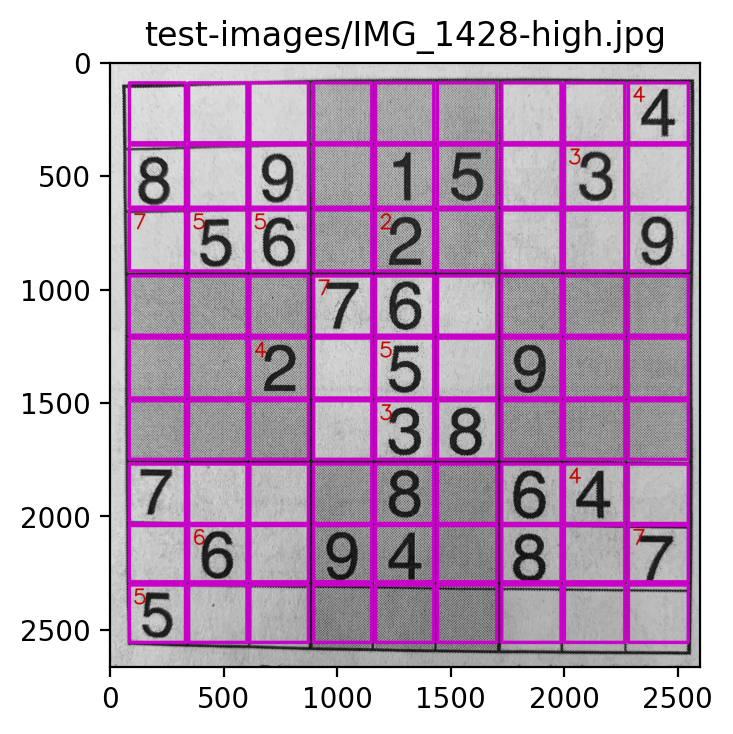

Start Time: 1660184824.26
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

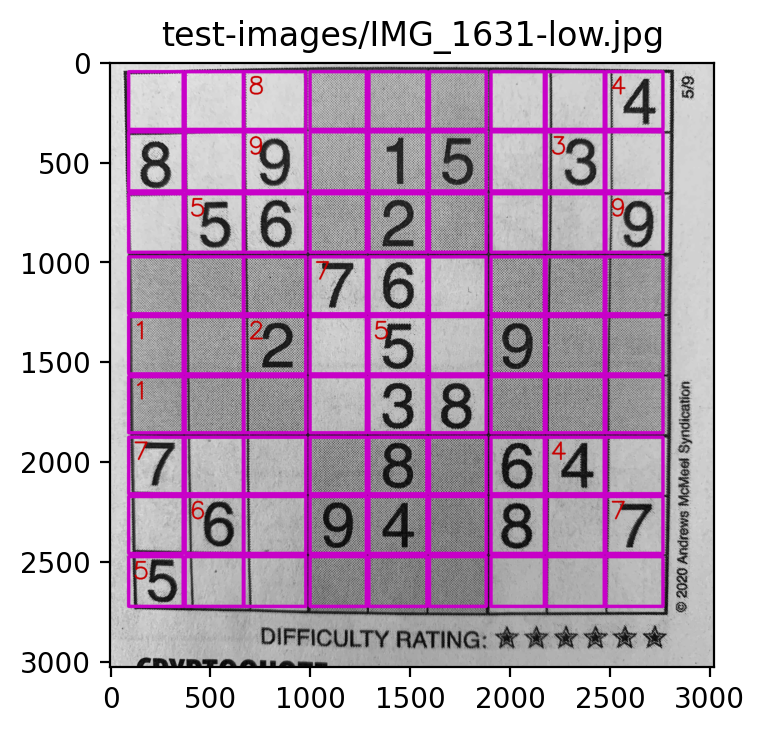

Start Time: 1660184837.56
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

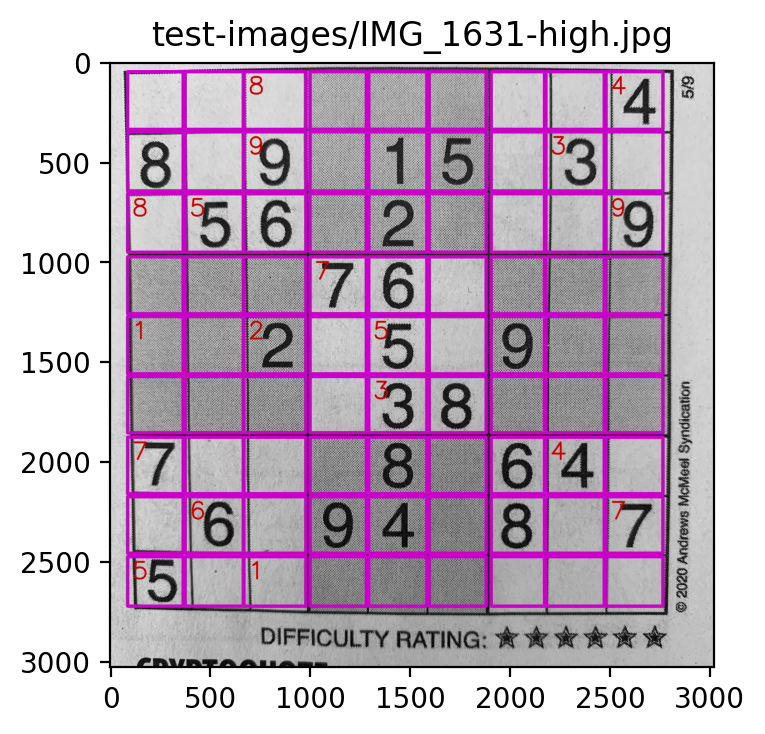

Start Time: 1660184852.24
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

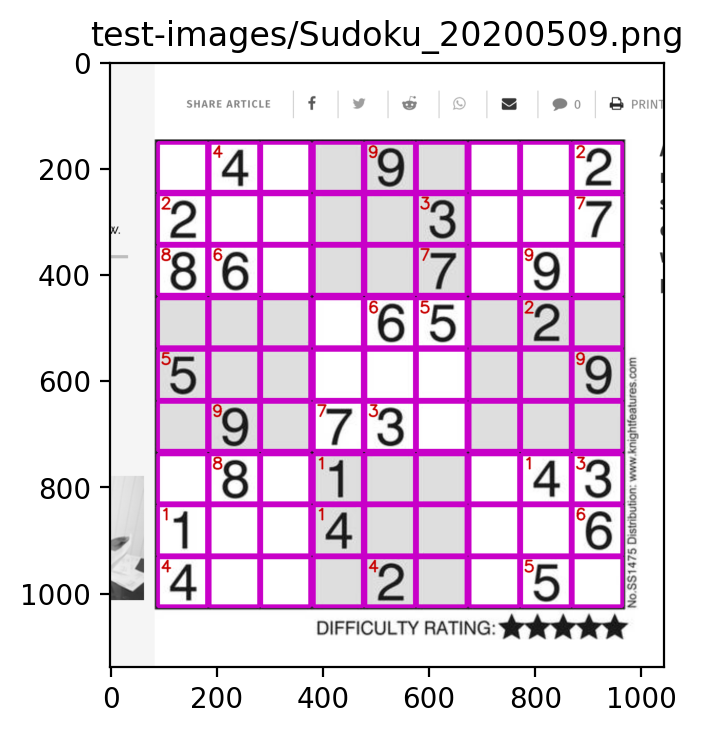

Start Time: 1660184860.62
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

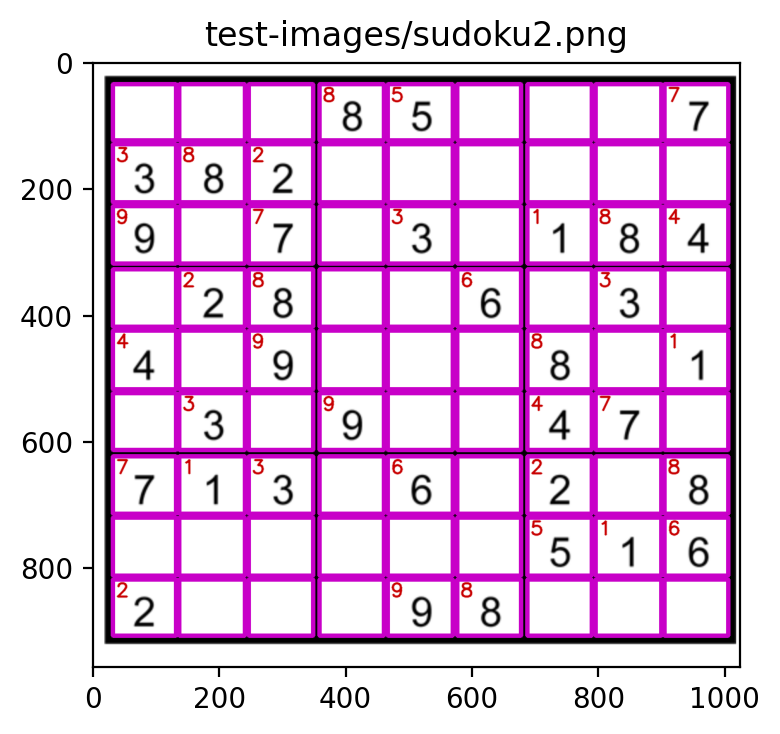

Start Time: 1660184871.65
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

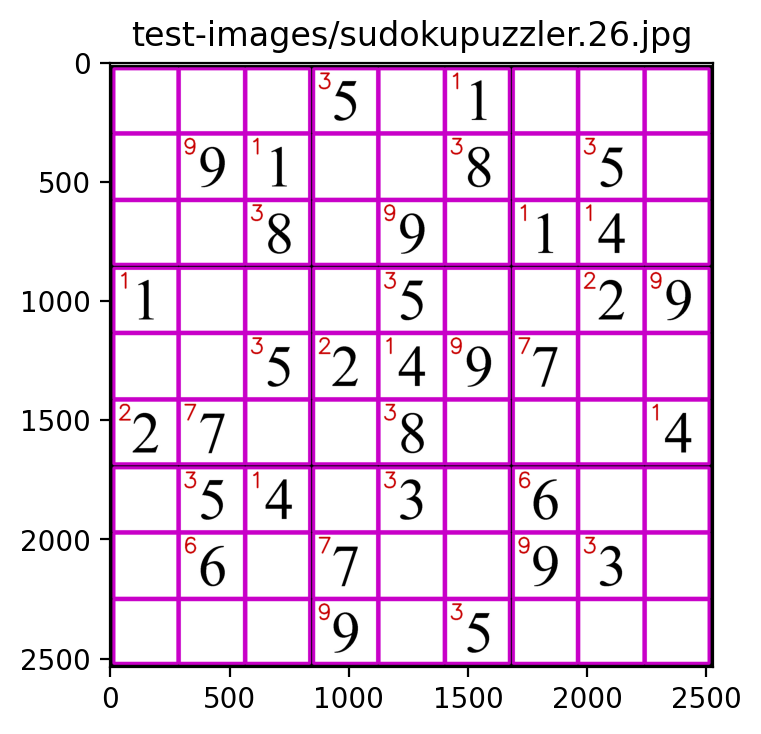

Start Time: 1660184882.56
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

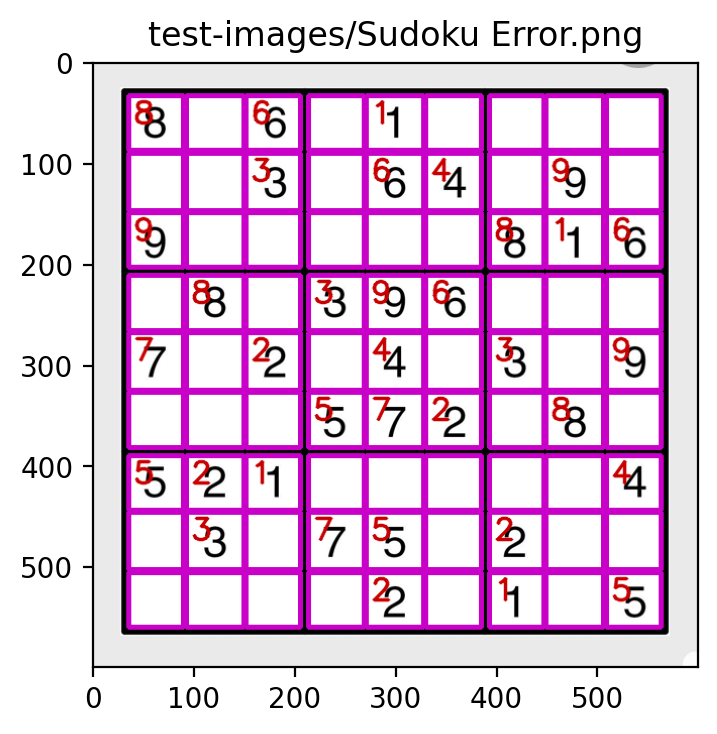

Start Time: 1660184894.23
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

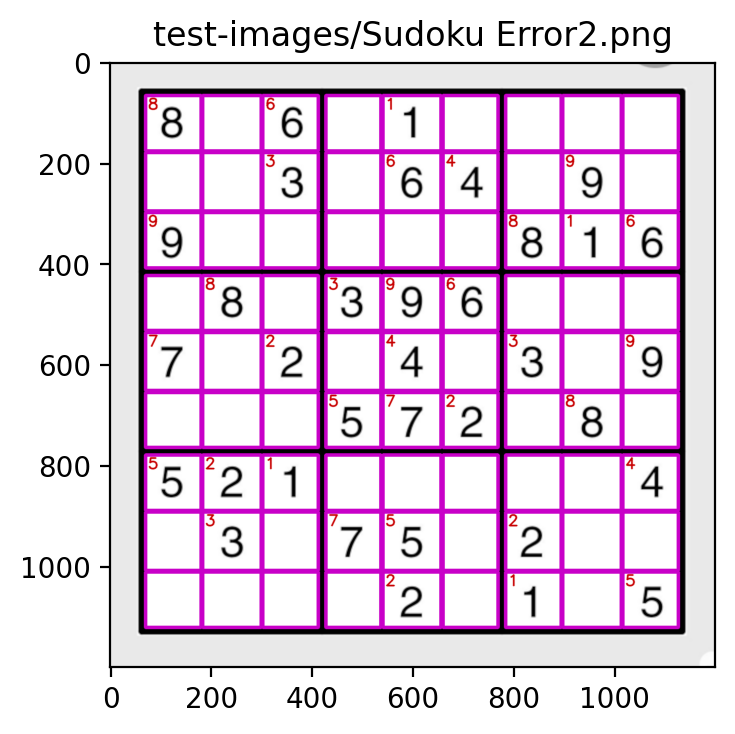

In [13]:
run_test('--psm 10 --oem 3 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016', display_image=DISPLAY_IMAGES)

Start Time: 1660184905.67
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

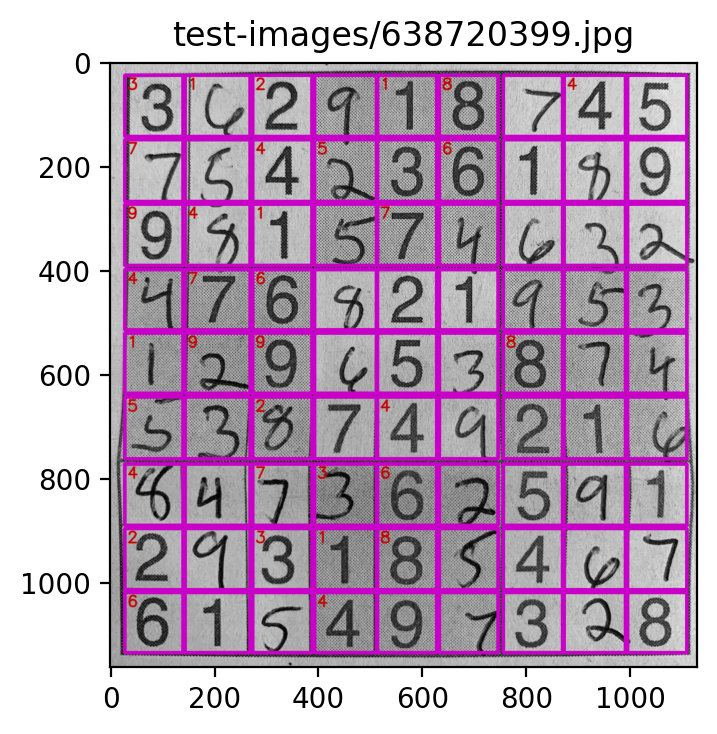

Start Time: 1660184913.81
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

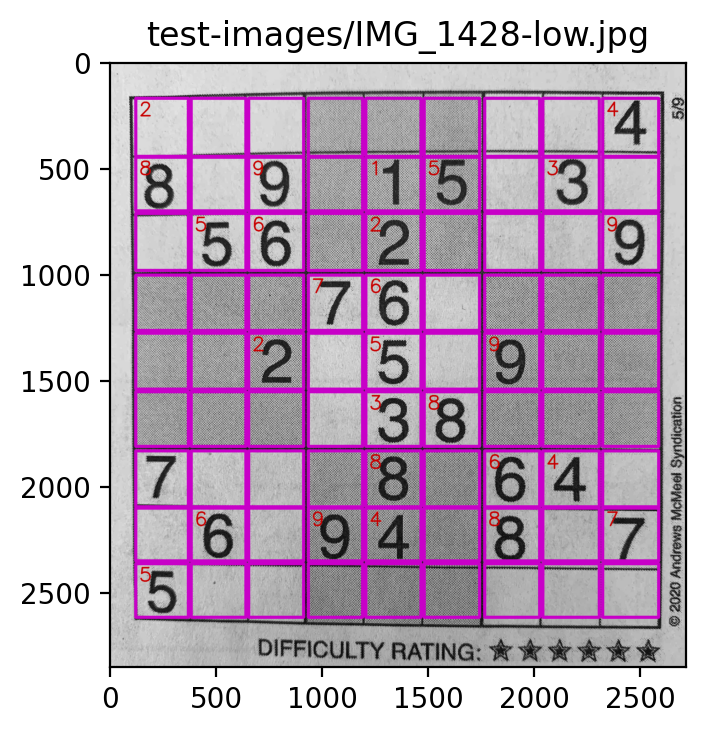

Start Time: 1660184924.49
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

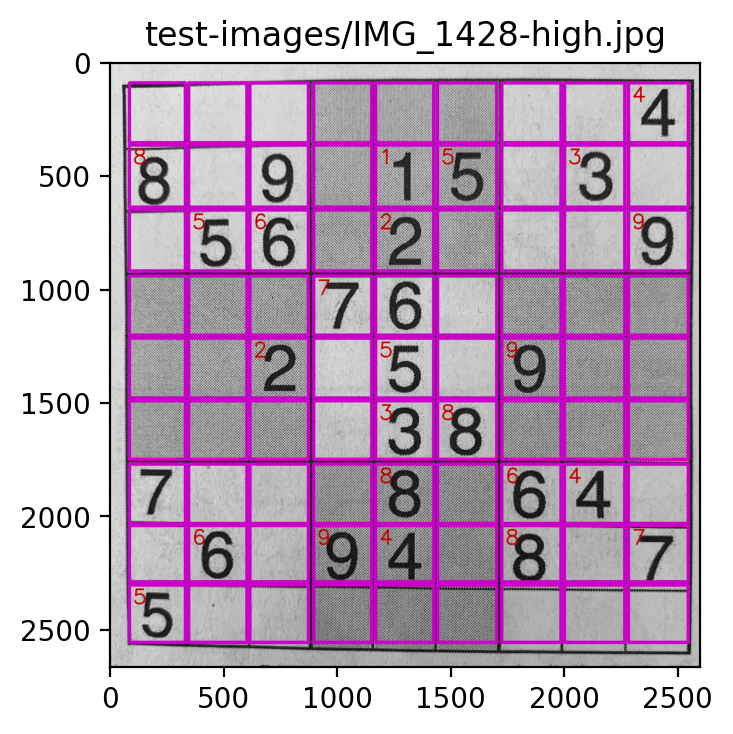

Start Time: 1660184934.59
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

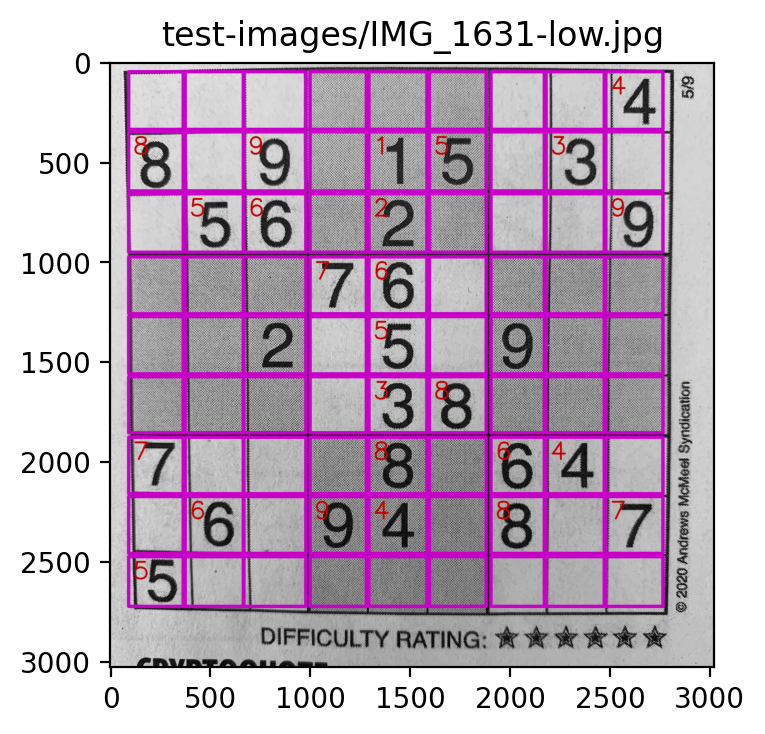

Start Time: 1660184945.15
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

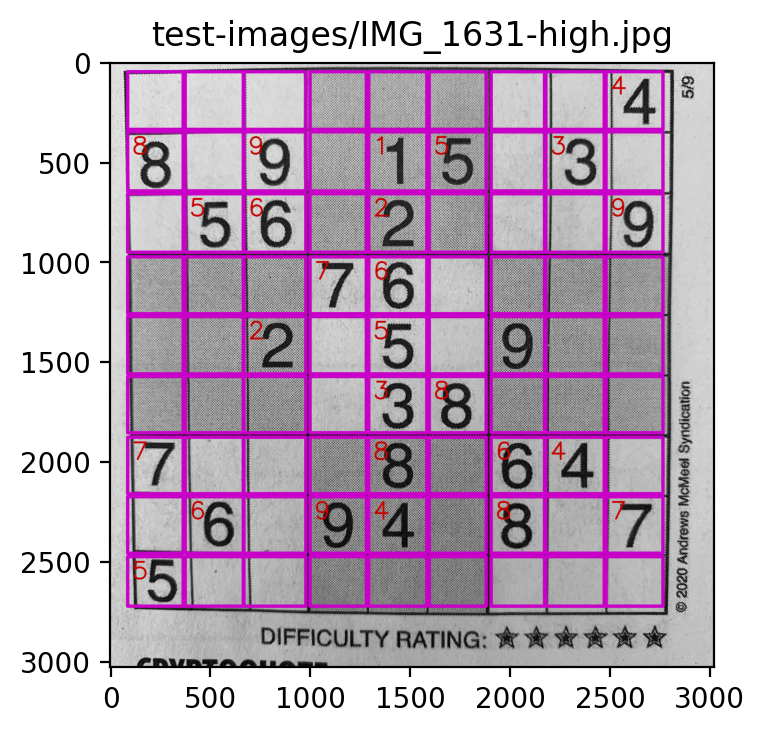

Start Time: 1660184958.01
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

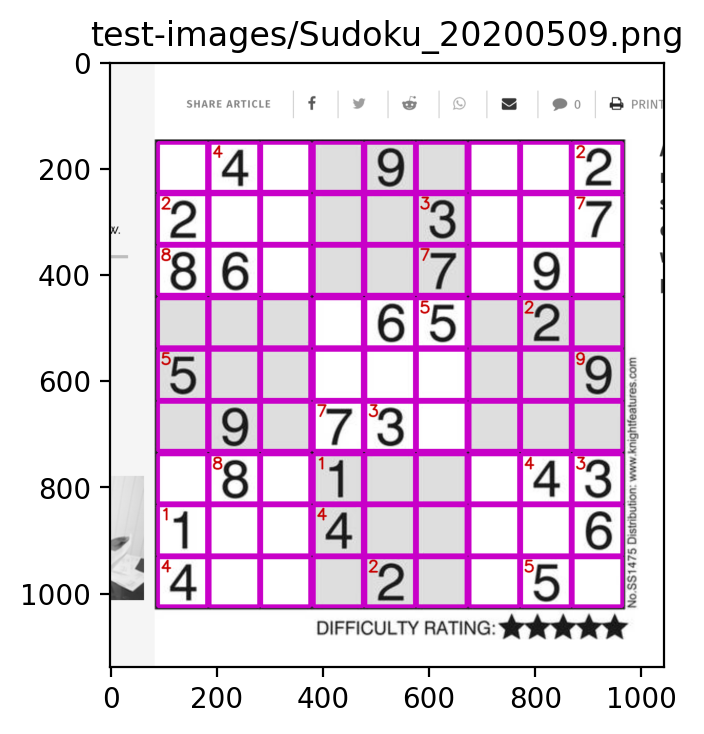

Start Time: 1660184965.90
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

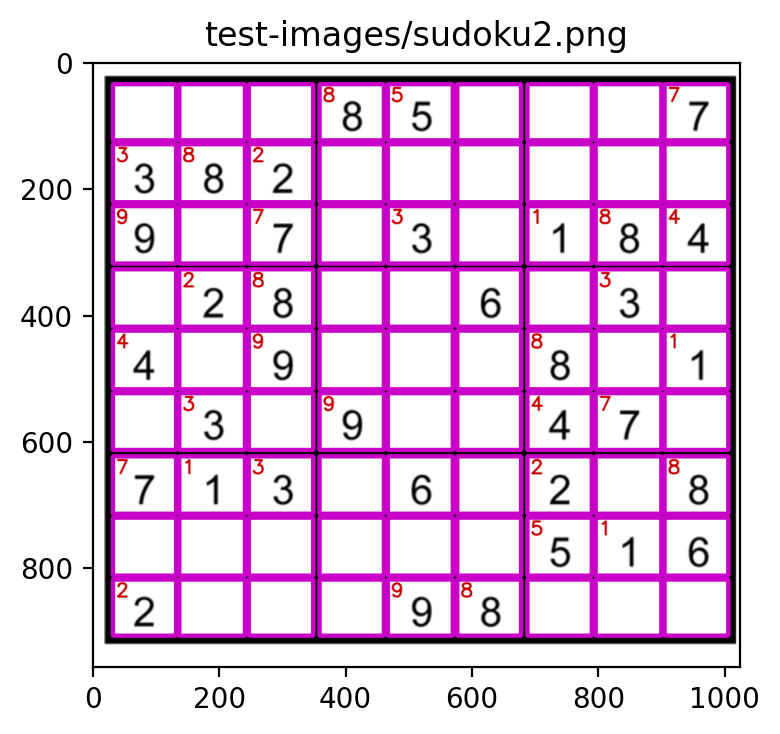

Start Time: 1660184975.46
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

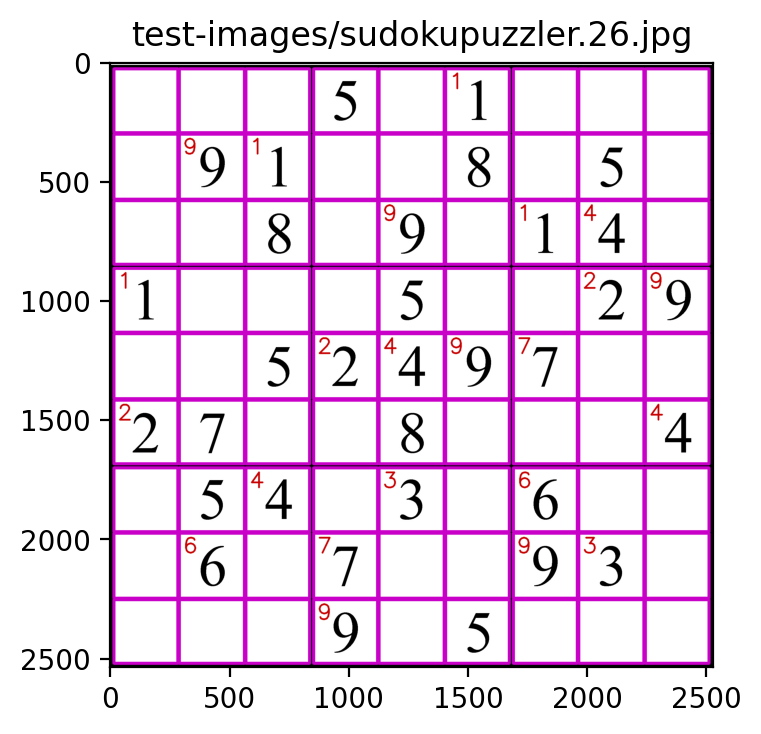

Start Time: 1660184985.31
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

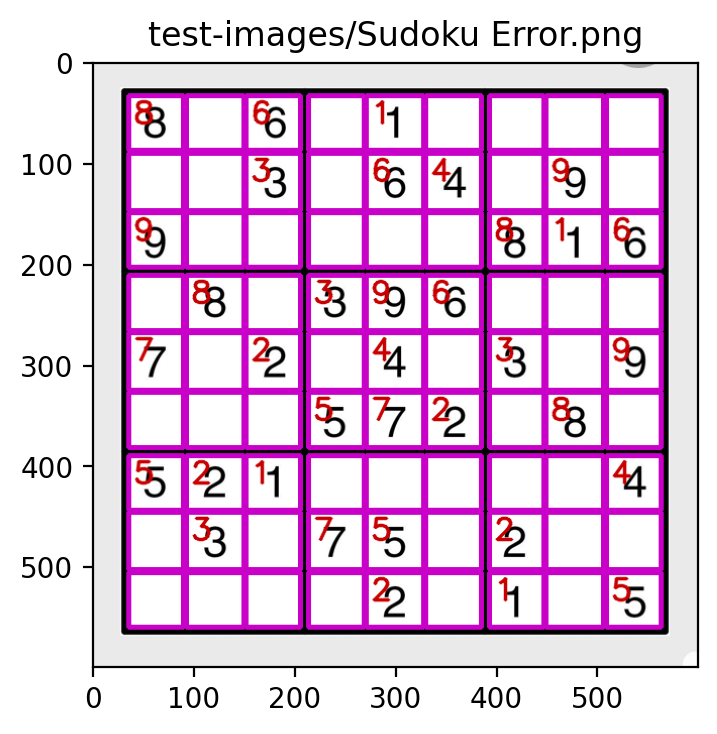

Start Time: 1660184995.37
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

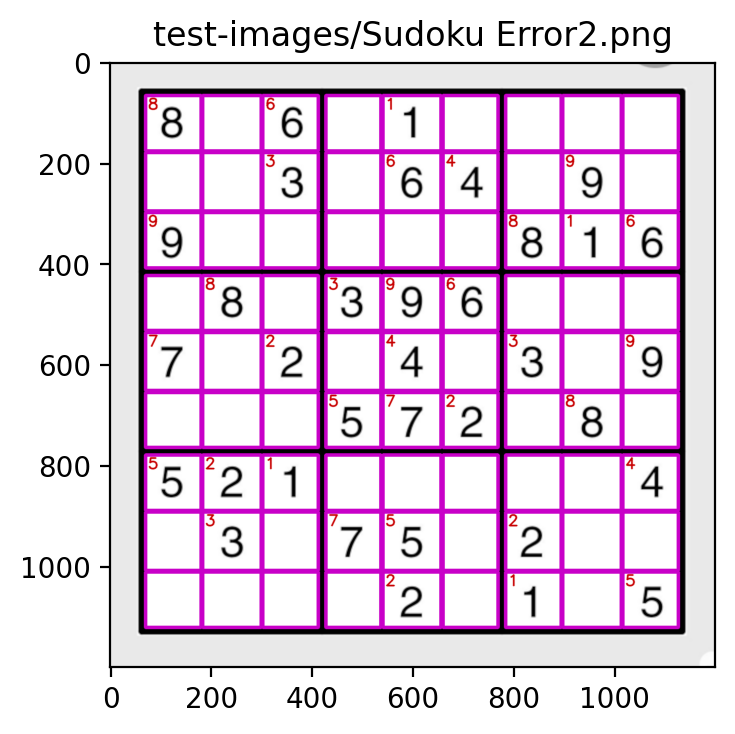

In [14]:
run_test('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Sept_2017', display_image=DISPLAY_IMAGES)
# This test fails with oem value of 0 and 2
#
# This is tied for the best for digital photos

Start Time: 1660185007.19
Image Size: 1311898. Ratio of std color counts to size: 4.16.
Image type: digital_pic

Image width: 1129
Image height: 1162
Minimum side: 1129
Minimum line length: 564
Max line gap: 22

Threshold: 564
Horizontal lines: 59
Vertical lines: 50
Rejected lines: 85
x coords before refactoring: [[18, 23], [28, 140], [144, 269], [271, 337], [341, 386], [395, 439], [441, 508], [513, 552], [554, 581], [583, 585], [590, 628], [633, 746], [756, 870], [873, 991], [995, 1109]]
y coords before refactoring: [[23, 141], [147, 266], [271, 389], [397, 513], [519, 635], [642, 761], [771, 889], [895, 1013], [1018, 1134]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 4, 0, 0, 2]), array([116. , 116.3, 116.6, 116.9, 117.2, 117.5, 117.8, 118.1, 118.4,
       118.7, 119. ]))
Min width: 100.13, Max width: 129.91
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 2, 3, 0, 2, 0, 0, 1, 5]), array([  2. ,  14.3,

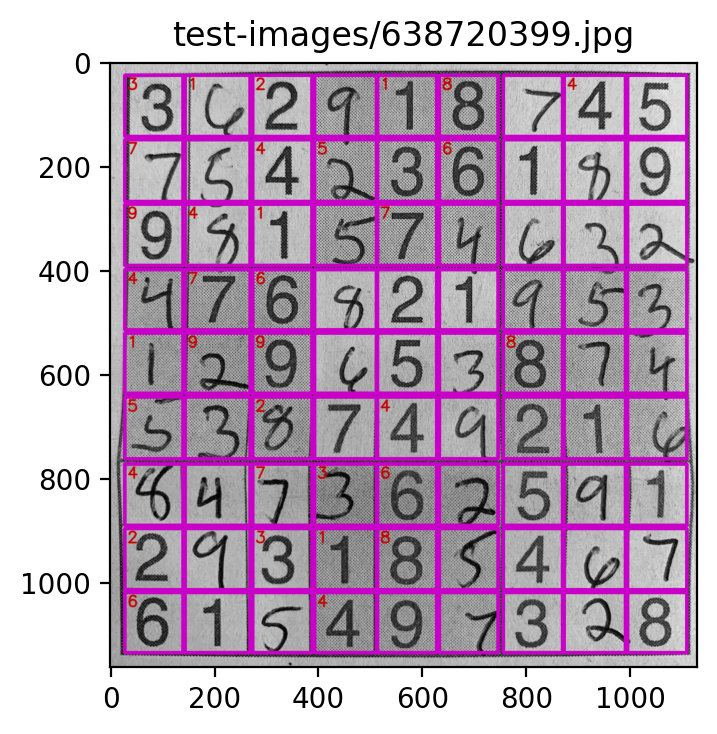

Start Time: 1660185014.83
Image Size: 7732186. Ratio of std color counts to size: 4.83.
Image type: digital_pic

Image width: 2714
Image height: 2849
Minimum side: 2714
Minimum line length: 1357
Max line gap: 54

Threshold: 1357
Horizontal lines: 110
Vertical lines: 184
Rejected lines: 134
x coords before refactoring: [[121, 369], [382, 640], [653, 912], [934, 1190], [1202, 1287], [1291, 1293], [1297, 1299], [1301, 1311], [1313, 1335], [1337, 1347], [1350, 1358], [1362, 1365], [1368, 1370], [1374, 1375], [1386, 1467], [1480, 1741], [1762, 1763], [1765, 2024], [2039, 2305], [2321, 2585]]
y coords before refactoring: [[166, 440], [444, 697], [709, 978], [1000, 1261], [1274, 1538], [1550, 1808], [1829, 2093], [2099, 2348], [2361, 2614], [2631, 2632], [2634, 2635]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.695000000000

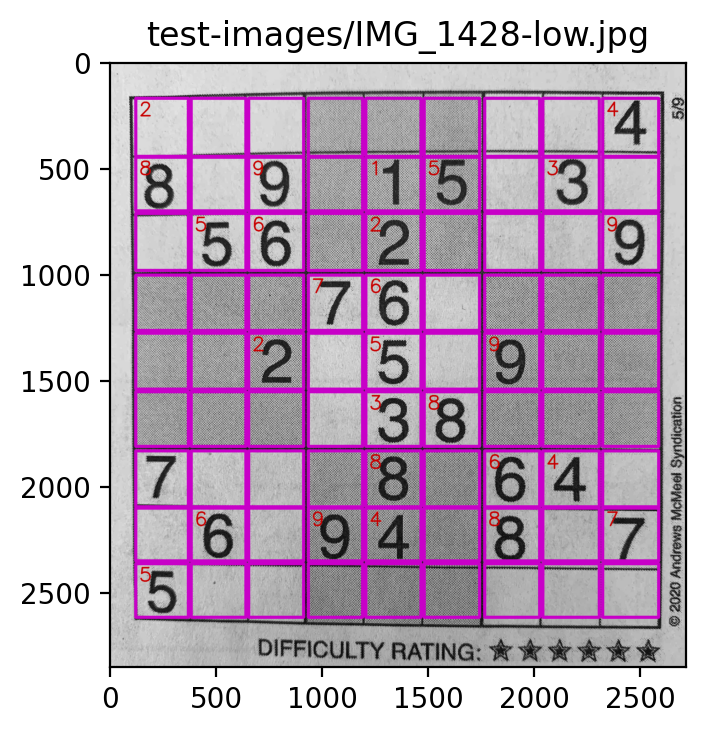

Start Time: 1660185025.39
Image Size: 6921200. Ratio of std color counts to size: 4.30.
Image type: digital_pic

Image width: 2600
Image height: 2662
Minimum side: 2600
Minimum line length: 1300
Max line gap: 52

Threshold: 1300
Horizontal lines: 134
Vertical lines: 185
Rejected lines: 78
x coords before refactoring: [[85, 332], [346, 603], [616, 874], [897, 1153], [1165, 1250], [1254, 1256], [1260, 1262], [1265, 1269], [1271, 1310], [1312, 1321], [1325, 1327], [1330, 1333], [1344, 1345], [1347, 1351], [1354, 1429], [1443, 1704], [1726, 1987], [2002, 2268], [2284, 2548]]
y coords before refactoring: [[87, 351], [361, 635], [647, 916], [938, 1199], [1212, 1476], [1488, 1746], [1767, 2029], [2038, 2286], [2300, 2553], [2569, 2571], [2574, 2575]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 0, 0, 0, 0, 0, 0, 0, 9]), array([  1. ,  28.3,  55.6,  82.9, 110.2, 137.5, 164.8, 192.1, 219.4,
       246.7, 274. ]))
Min width: 209.69500000000002, Max width: 301

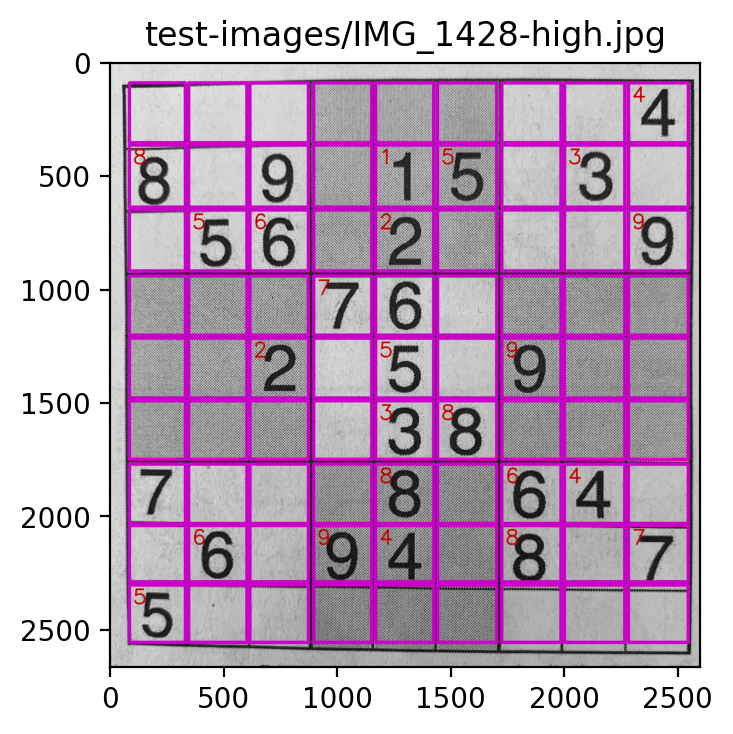

Start Time: 1660185035.70
Image Size: 9144576. Ratio of std color counts to size: 5.20.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 151
Rejected lines: 165
x coords before refactoring: [[88, 91], [93, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1394], [1398, 1402], [1404, 1447], [1449, 1453], [1456, 1460], [1463, 1465], [1469, 1473], [1475, 1478], [1482, 1484], [1490, 1491], [1496, 1498], [1501, 1584], [1599, 1883], [1907, 2174], [2177, 2178], [2183, 2474], [2482, 2768], [2770, 2772], [2782, 2783]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1570, 1851], [1873, 2156], [2170, 2455], [2471, 2720]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 1, 3, 2, 2]), array([249. , 253.7, 258.4, 263.1, 267.8, 272.5, 277.2, 281.9, 286.6,
       291.3, 

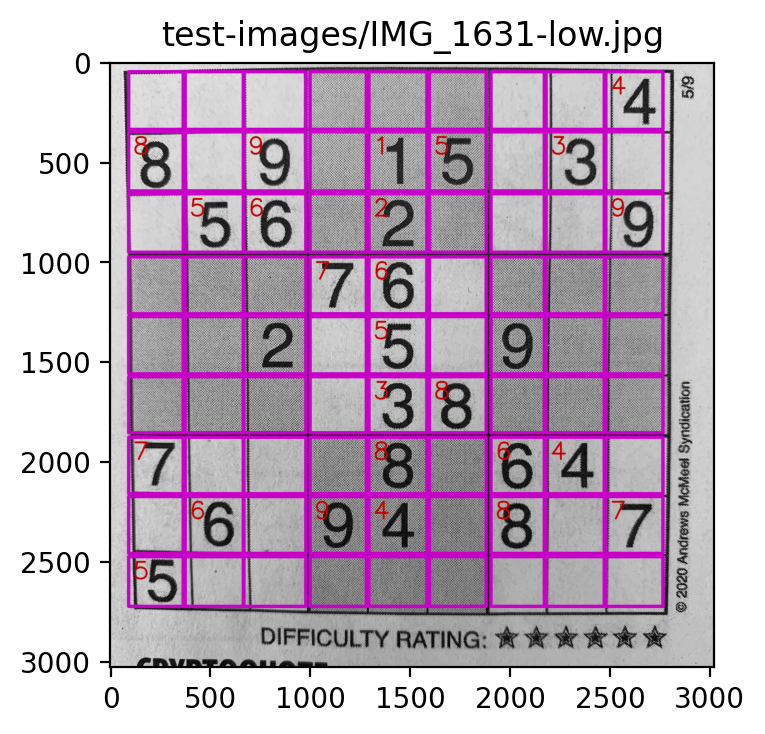

Start Time: 1660185046.36
Image Size: 9144576. Ratio of std color counts to size: 4.27.
Image type: digital_pic

Image width: 3024
Image height: 3024
Minimum side: 3024
Minimum line length: 1512
Max line gap: 60

Threshold: 1512
Horizontal lines: 152
Vertical lines: 142
Rejected lines: 165
x coords before refactoring: [[88, 366], [376, 667], [670, 980], [1001, 1283], [1296, 1389], [1391, 1395], [1398, 1441], [1443, 1447], [1449, 1453], [1456, 1460], [1462, 1466], [1469, 1478], [1482, 1484], [1488, 1491], [1496, 1498], [1500, 1584], [1598, 1883], [1908, 2175], [2182, 2474], [2483, 2768], [2772, 2774], [2781, 2782]]
y coords before refactoring: [[43, 332], [344, 640], [654, 947], [970, 1255], [1269, 1556], [1569, 1851], [1873, 2156], [2171, 2454], [2471, 2719], [2735, 2737]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 0, 0, 0, 0, 0, 0, 1, 8]), array([  2. ,  31.4,  60.8,  90.2, 119.6, 149. , 178.4, 207.8, 237.2,
       266.6, 296. ]))
Min width: 201.

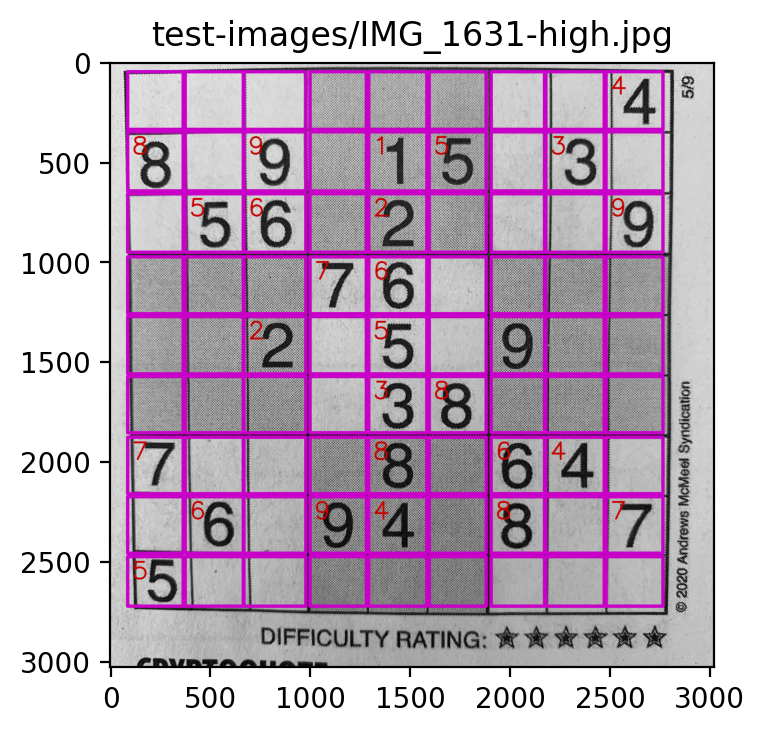

Start Time: 1660185059.01
Image Size: 1188072. Ratio of std color counts to size: 26.37.
Image type: screen_cap

Image width: 1044
Image height: 1138
Minimum side: 1044
Minimum line length: 522
Max line gap: 20

Threshold: 522
Horizontal lines: 44
Vertical lines: 42
Rejected lines: 0
x coords before refactoring: [[90, 182], [187, 280], [284, 376], [383, 475], [480, 573], [577, 670], [676, 769], [773, 866], [870, 963]]
y coords before refactoring: [[150, 242], [247, 340], [344, 436], [443, 535], [540, 634], [638, 730], [737, 829], [833, 927], [931, 1023]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([6, 0, 0, 0, 0, 1, 0, 0, 0, 2]), array([92. , 92.2, 92.4, 92.6, 92.8, 93. , 93.2, 93.4, 93.6, 93.8, 94. ]))
Min width: 78.2, Max width: 101.42000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 0, 0, 0, 0, 0, 0, 0, 0, 6]), array([92. , 92.1, 92.2, 92.3, 92.4, 92.5, 92.6, 92.7, 92.8, 92.9, 93. ]))
Min width: 78.965, Max wid

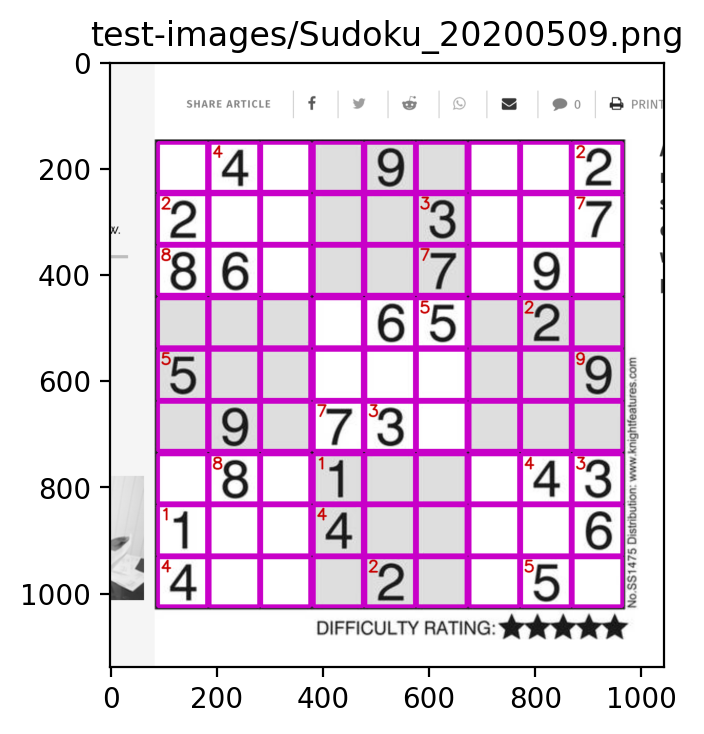

Start Time: 1660185066.75
Image Size: 978944. Ratio of std color counts to size: 47.46.
Image type: screen_cap

Image width: 1024
Image height: 956
Minimum side: 956
Minimum line length: 478
Max line gap: 19

Threshold: 478
Horizontal lines: 73
Vertical lines: 72
Rejected lines: 0
x coords before refactoring: [[31, 131], [136, 240], [246, 348], [358, 460], [466, 569], [576, 677], [687, 789], [795, 899], [904, 1005]]
y coords before refactoring: [[33, 122], [128, 220], [226, 317], [326, 417], [423, 516], [522, 612], [622, 713], [719, 811], [817, 906]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 0, 1, 0, 0, 3, 0, 2, 0, 1]), array([89. , 89.4, 89.8, 90.2, 90.6, 91. , 91.4, 91.8, 92.2, 92.6, 93. ]))
Min width: 77.35, Max width: 100.54000000000002
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([1, 0, 2, 0, 0, 3, 0, 1, 0, 2]), array([100. , 100.4, 100.8, 101.2, 101.6, 102. , 102.4, 102.8, 103.2,
       103.6, 104. ]))
Min width: 

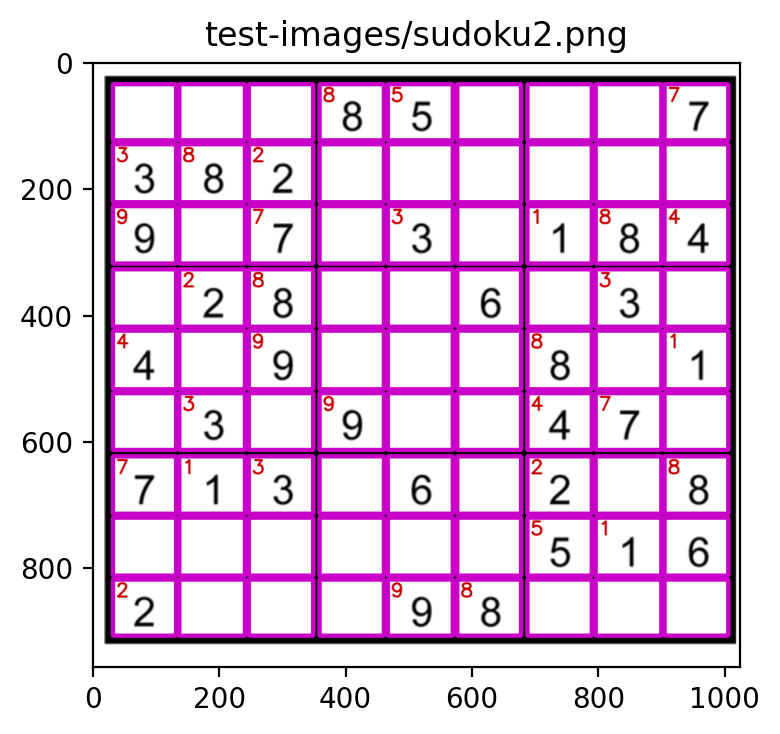

Start Time: 1660185076.25
Image Size: 6403418. Ratio of std color counts to size: 56.35.
Image type: screen_cap

Image width: 2527
Image height: 2534
Minimum side: 2527
Minimum line length: 1263
Max line gap: 50

Threshold: 1263
Horizontal lines: 93
Vertical lines: 94
Rejected lines: 0
x coords before refactoring: [[16, 284], [290, 563], [569, 836], [853, 1121], [1127, 1400], [1406, 1673], [1690, 1958], [1964, 2237], [2243, 2510]]
y coords before refactoring: [[24, 292], [298, 571], [577, 844], [861, 1129], [1135, 1408], [1414, 1681], [1698, 1966], [1972, 2245], [2251, 2518]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271.2, 271.8,
       272.4, 273. ]))
Min width: 226.95, Max width: 295.02000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([3, 3, 0, 0, 0, 0, 0, 0, 0, 3]), array([267. , 267.6, 268.2, 268.8, 269.4, 270. , 270.6, 271

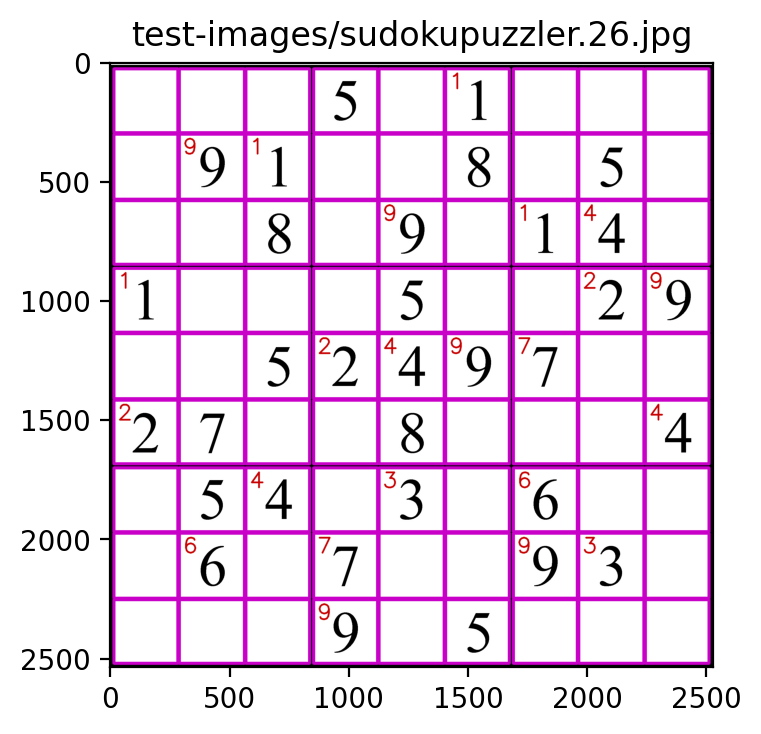

Start Time: 1660185085.95
Image Size: 359400. Ratio of std color counts to size: 40.12.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 600
Image height: 599
Minimum side: 599
Minimum line length: 299
Max line gap: 11

Threshold: 299
Horizontal lines: 36
Vertical lines: 36
Rejected lines: 0
x coords before refactoring: [[35, 89], [92, 149], [151, 205], [213, 268], [270, 327], [329, 384], [392, 446], [448, 505], [508, 562]]
y coords before refactoring: [[32, 86], [89, 146], [148, 202], [210, 265], [267, 324], [326, 381], [389, 443], [445, 502], [505, 559]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 0, 3]), array([54. , 54.3, 54.6, 54.9, 55.2, 55.5, 55.8, 56.1, 56.4, 56.7, 57. ]))
Min width: 45.9, Max width: 59.730000000000004
Refactor x coordinates
Coordinate widths histogram for refactoring:
(array([4, 0, 0, 2, 0, 0, 0, 0, 

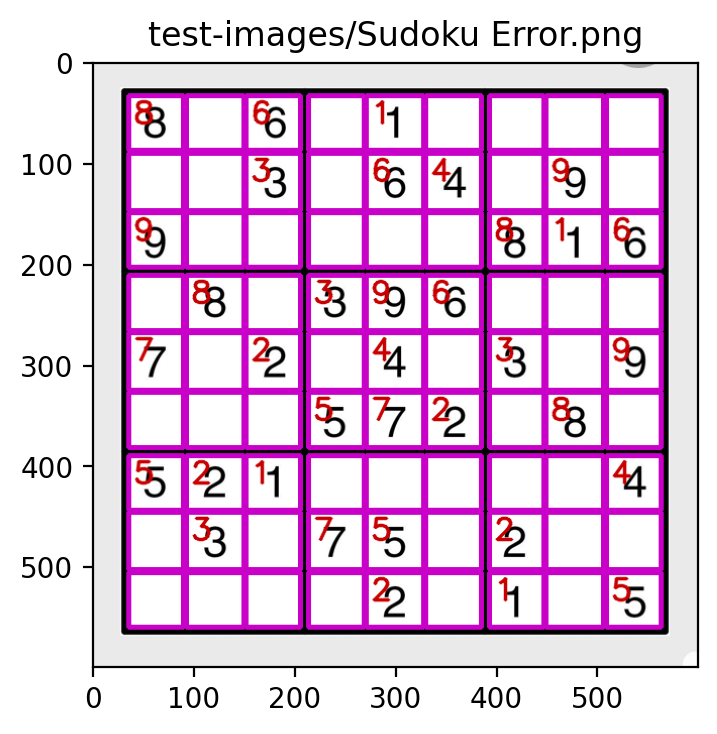

Start Time: 1660185096.11
Image Size: 1437600. Ratio of std color counts to size: 38.31.
Image type: screen_cap
Tesseract config: --psm 10 --oem 0 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Nov_2016

Image width: 1200
Image height: 1198
Minimum side: 1198
Minimum line length: 599
Max line gap: 23

Threshold: 599
Horizontal lines: 70
Vertical lines: 70
Rejected lines: 0
x coords before refactoring: [[70, 180], [183, 299], [302, 412], [427, 536], [540, 655], [659, 768], [783, 893], [896, 1012], [1015, 1125]]
y coords before refactoring: [[64, 174], [177, 293], [296, 406], [421, 530], [534, 649], [653, 762], [777, 887], [890, 1006], [1009, 1119]]
Refactor y coordinates
Coordinate widths histogram for refactoring:
(array([2, 4, 0, 0, 0, 0, 0, 0, 1, 2]), array([109. , 109.7, 110.4, 111.1, 111.8, 112.5, 113.2, 113.9, 114.6,
       115.3, 116. ]))
Min width: 92.64999999999999, Max width: 121.44000000000001
Refactor x coordinates
Coordinate widths histogram for 

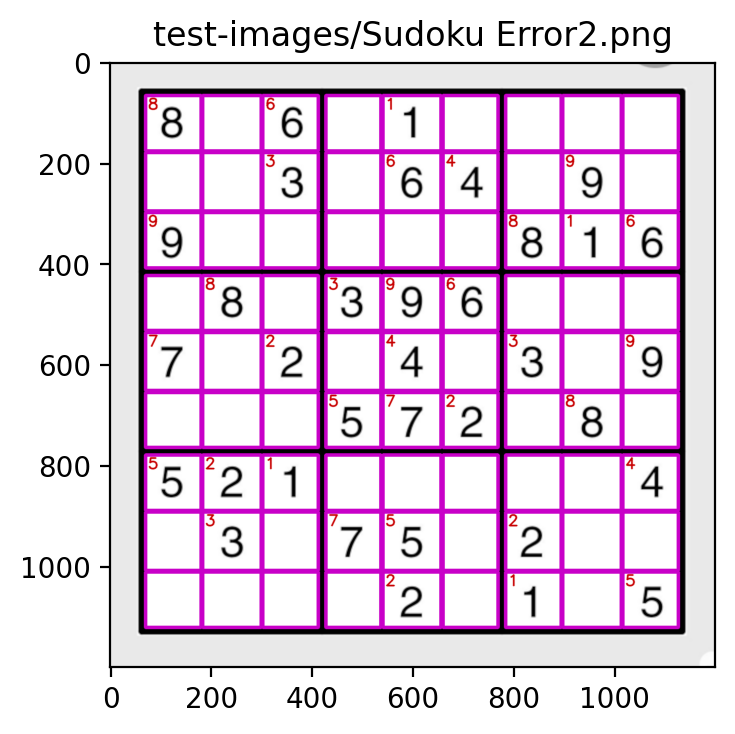

In [15]:
run_test('--psm 10 --oem 3 -l eng -c tessedit_char_whitelist=123456789 --tessdata-dir ./tessdata/4.00_Sept_2017', display_image=DISPLAY_IMAGES)
#
# This is tied for the best for digital photos

In [16]:
for score in all_scores:
    print(score)

('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/638720399.jpg', 60)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/IMG_1428-low.jpg', 74)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/IMG_1428-high.jpg', 76)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/IMG_1631-low.jpg', 71)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/IMG_1631-high.jpg', 72)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/Sudoku_20200509.png', 74)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/sudoku2.png', 78)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/sudokupuzzler.26.jpg', 69)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/Sudoku Error.png', 81)
('--psm 10 --oem 1 -l eng -c tessedit_char_whitelist=123456789', 'test-images/Sudoku Error